<a href="https://colab.research.google.com/github/sefeoglu/Mask_Detection/blob/master/Mask_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#  **<font color = "purple"><center>Mask Detection</center></font>**

### **<font color="green"> Information about the Group</font>**
**Goup Name :** Overfitters

*  [Colab notebook link ](https://colab.research.google.com/drive/1DOA8knYK-8cICuyOWmNMaH6JZDvF0hnm?usp=sharing)
* put the drive folder to your own drive

[Drive folder link](https://drive.google.com/drive/folders/1iR7rhVijYAx2whWOoJu43pxbdXaYvR5h?usp=sharing)


we changed the archive.zip as format mask->annotations and images because the given archive.zip was broken and we could not use the unzip.

# **<font color="purple">Problem Definition and Motivation</font>**




The problem we are solving is detecting whether people are wearing their face masks or not, and if the mask is working correctly. Now the images might have more than one person in it, so we first need to extract each person’s faces and then check whether the mask is worn or not and correctly.

We have 4072 boxes on the image dataset. The boxes on the images show the mask, incorrect mask and no mask, and we want to develop a model that predicts the labels of these boxes correctly.

**Instructions:**


**1.**  Get the drive folder that we shared the link above and copy to your own drive

**2.**  If you want to test your own private test dataset and public test dataset, skip the training part of the model and run the model loading part which we defined on the section regarding private dataset testing below.

**3.** We can support you while testing your private test dataset.

**4.** Output folder on the drive belongs to the model which does not have any custom data augmentation. Output_2 folder there is belonging to the model trained with custom data augmentation techniques.

**5.** The results of COCO mAP for the public test dataset are in test_result.json and aug_test_result.json under the drive folder.

# **Installations**

In [ ]:
!pip install pyyaml==5.1
!pip install imgaug>==0.2.5
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version


1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



* If you get a warning regarding "Restart Runtime" because of PIL, please do it, and then continue the running the code lines

In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

In [ ]:
import PIL
print(PIL.PILLOW_VERSION)

8.0.1


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: DeprecationWarning: PILLOW_VERSION is deprecated and will be removed in a future release. Use __version__ instead.
  


# **Libraries**

Definition of the necessary libraries

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
 
# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow
 
# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor, DefaultTrainer
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.structures import BoxMode

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [ ]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
 
from fastai.vision import *

In [ ]:
from zipfile import ZipFile 
import pandas as pd
from os import listdir
from os.path import isfile, join
from bs4 import BeautifulSoup as bs

In [ ]:
import numpy as np # linear algebra
import os
for dirname, _, filenames in os.walk('/mask/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
import shutil
import matplotlib.pyplot as plt


path_cpy = "mask"

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

* Get the archive.zip and DatasetSplit.csv from drive using these lines below

In [ ]:
!cp drive/MyDrive/CompetitionDL/archive.zip ./
!cp drive/MyDrive/CompetitionDL/DatasetSplit.csv ./
!unzip archive.zip

# **Load Data and split it to train and test set**

**Helper functions**

In [ ]:
def gen_box(obj):
#     Getting bounding box coordinates
    xmin = int(obj.find('xmin').text)
    xmax = int(obj.find('xmax').text)
    ymin = int(obj.find('ymin').text)
    ymax = int(obj.find('ymax').text)
    
    return [xmin, ymin, xmax, ymax]

def gen_label(obj):
    if obj.find('name').text == "with_mask":
        return "mask" #     for with_mask label set to 2
    elif obj.find('name').text == "mask_weared_incorrect":
        return "incorrect_mask"     # for mask_weared_incorrect label set to 1
    return "no_mask" #     for without_mask label set to 0

**Getting Data from xml file**

In [ ]:
def gen_list(path):
    coordinates = []
    labels = []
    name= []
    size = []
    xml_list  = list(sorted(os.listdir(path+"/annotations")))
    img_list = list(sorted(os.listdir(path+"/images")))
    total = len(img_list)
    #assert len(img_list) == len(xml_list)
    counter = 0
    for xml in xml_list:
      with open(path+f"/annotations/{xml}") as file:
        data = file.read()
        soup = bs(data, "xml")
        xml_objs = soup.find_all('object')
        counter +=1
        for i in xml_objs:
          coordinates.append(gen_box(i))
          labels.append(gen_label(i))
          name.append(soup.find('filename').text)
        print(f"file processed {counter} / {total}...")
    return coordinates, name, labels, size

In [ ]:
coordinates, name, labels, size = gen_list(path_cpy)

file processed 1 / 853...
file processed 2 / 853...
file processed 3 / 853...
file processed 4 / 853...
file processed 5 / 853...
file processed 6 / 853...
file processed 7 / 853...
file processed 8 / 853...
file processed 9 / 853...
file processed 10 / 853...
file processed 11 / 853...
file processed 12 / 853...
file processed 13 / 853...
file processed 14 / 853...
file processed 15 / 853...
file processed 16 / 853...
file processed 17 / 853...
file processed 18 / 853...
file processed 19 / 853...
file processed 20 / 853...
file processed 21 / 853...
file processed 22 / 853...
file processed 23 / 853...
file processed 24 / 853...
file processed 25 / 853...
file processed 26 / 853...
file processed 27 / 853...
file processed 28 / 853...
file processed 29 / 853...
file processed 30 / 853...
file processed 31 / 853...
file processed 32 / 853...
file processed 33 / 853...
file processed 34 / 853...
file processed 35 / 853...
file processed 36 / 853...
file processed 37 / 853...
file proce

**Making DataFrame from data extracted from XML**

In [ ]:
def initialize_frame(df, name, labels):
  df['name'] = name
  df['labels'] = labels
  # initializing labels
  df['xmin'] = 0
  df['ymin'] = 0
  df['xmax'] = 0
  df['ymax'] = 0
  df['height'] = np.zeros(len(df['name']))
  df['width'] = np.zeros(len(df['name']))

**Assigning values to columns**


In [ ]:
def assign_value_dataframe(df, coordinates):

  for i,(xmin,ymin,xmax,ymax) in enumerate(coordinates):
    df['xmin'][i] = xmin
    df['ymin'][i] = ymin
    df['xmax'][i] = xmax
    df['ymax'][i] = ymax

  for i,fname in enumerate(name):
    img = cv2.imread(path_cpy+'/images/'+fname)
    height = img.shape[0]
    width = img.shape[1]
    df['height'][i] = height
    df['width'][i] = width

In [ ]:
df = DataFrame()
initialize_frame(df, name, labels)
assign_value_dataframe(df, coordinates)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: Se

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4072 entries, 0 to 4071
Data columns (total 8 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   name    4072 non-null   object 
 1   labels  4072 non-null   object 
 2   xmin    4072 non-null   int64  
 3   ymin    4072 non-null   int64  
 4   xmax    4072 non-null   int64  
 5   ymax    4072 non-null   int64  
 6   height  4072 non-null   float64
 7   width   4072 non-null   float64
dtypes: float64(2), int64(4), object(2)
memory usage: 254.6+ KB


**Splitting Data into Train and Test set**

In [ ]:
datasetSplit = pd.read_csv("DatasetSplit.csv",delimiter=",")

In [ ]:
datasetSplit 

,Unnamed: 0,0
0,xml train:,"['maksssksksss0.xml', 'maksssksksss100.xml', '..."
1,img train:,"['maksssksksss0.png', 'maksssksksss100.png', '..."
2,xml validation:,"['maksssksksss1.xml', 'maksssksksss121.xml', '..."
3,img validation:,"['maksssksksss1.png', 'maksssksksss121.png', '..."
4,xml test:,"['maksssksksss10.xml', 'maksssksksss103.xml', ..."
5,img test:,"['maksssksksss10.png', 'maksssksksss103.png', ..."


In [ ]:
train_files = datasetSplit["0"][1][2:-2].replace("', '", ",").split(',')
test_files = datasetSplit["0"][5][2:-2].replace("', '", ",").split(',')
val_files = datasetSplit["0"][3][2:-2].replace("', '", ",").split(',')

In [ ]:
train_df = df[df.name.isin(train_files)]
test_df = df[df.name.isin(test_files)]
val_df = df[df.name.isin(val_files)]
classes = ['no_mask', 'incorrect_mask', 'mask']

In [ ]:
train_df.head(5)

,name,labels,xmin,ymin,xmax,ymax,height,width
0,maksssksksss0.png,no_mask,79,105,109,142,366.0,512.0
1,maksssksksss0.png,mask,185,100,226,144,366.0,512.0
2,maksssksksss0.png,no_mask,325,90,360,141,366.0,512.0
13,maksssksksss100.png,mask,189,30,245,88,226.0,400.0
14,maksssksksss100.png,mask,387,54,400,75,226.0,400.0


**Creating function that formats data in COCO Dateset format**

In [ ]:
def my_dataset_function(df,classes):
    data_list = []
    for i,fname in enumerate(df['name'].unique()):
        record = dict()
        #gtetting all rows with nmae as fnmae
        image_df = df[df['name']==fname]
        #image path
        img_path = path_cpy +'/images/'+fname
        #entring recprds
        record['file_name'] = img_path
        record['image_id'] = i
        record['height'] = int(image_df.iloc[0].height)
        record['width'] = int(image_df.iloc[0].width)
        
        objs = []
        for _,row in image_df.iterrows():
          xmin = int(row.xmin)
          ymin = int(row.ymin)
          xmax = int(row.xmax)
          ymax = int(row.ymax)

          poly = [
                  (xmin, ymin), (xmax, ymin),
                  (xmax, ymax), (xmin, ymax)
                  ]
          poly = list(itertools.chain.from_iterable(poly))

          obj = {
              "bbox": [xmin, ymin, xmax, ymax],
              "bbox_mode": BoxMode.XYXY_ABS,
              "segmentation": [poly],
              "category_id": classes.index(row.labels),
              "iscrowd": 0
              }
          objs.append(obj)
        record["annotations"] = objs
        data_list.append(record)
    return data_list

**Registering Dataset**

In [ ]:
for d in ["train", "val", "test"]:
  if d == "train":
    DatasetCatalog.register("data_" + d, lambda:my_dataset_function(train_df, classes))
    MetadataCatalog.get("data_" + d).set(thing_classes=classes)
  elif d == "val":
    DatasetCatalog.register("data_" + d, lambda:my_dataset_function(val_df, classes))
    MetadataCatalog.get("data_" + d).set(thing_classes=classes)
  else :
    DatasetCatalog.register("data_" + d, lambda:my_dataset_function(test_df, classes))
    MetadataCatalog.get("data_" + d).set(thing_classes=classes)

statement_metadata = MetadataCatalog.get("data_train")

In [ ]:
len(train_df),len(test_df)

(3149, 404)

# **Visualisation Steps**

We visualize the number of images in our dataset according their labels.

<font color="purple">**Disccusion about the Dataset:**</font>

Overview about the incorrect_mask label:

* The number of incorrect mask on all dataset: 123
* The number of incorrect mask on train set: 101
* The number of incorrect mask on test set: 7

As you can see from the figures below, the lack of the number of incorrect_mask might cause misclassification problem on the test.
On the other hand, the number of mask labels is enough to train a model.

In [ ]:
print("The number of incorrect mask on all dataset:{0}".format(len(df[df.labels=="incorrect_mask"])))
print("The number of incorrect mask on train set:{0}".format(len(train_df[train_df.labels=="incorrect_mask"])))
print("The number of incorrect mask on test set:{0}".format(len(test_df[test_df.labels=="incorrect_mask"])))

The number of incorrect mask on all dataset:123
The number of incorrect mask on train set:101
The number of incorrect mask on test set:7


Text(0.5, 0.98, 'Overview of all')

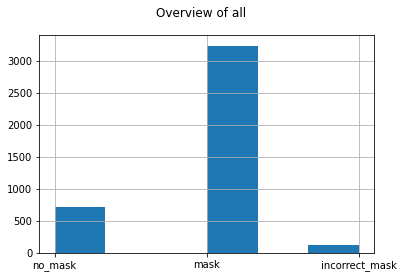

In [ ]:
df.labels.hist(bins=6)
plt.suptitle("Overview of all")

Text(0.5, 0.98, 'Overview of Training Dataset')

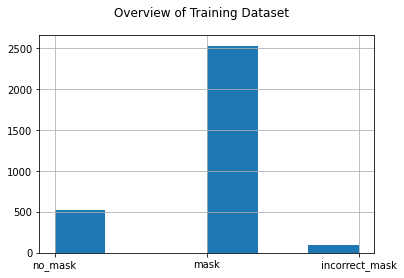

In [ ]:
train_df.labels.hist(bins=6)
plt.suptitle("Overview of Training Dataset")

Text(0.5, 0.98, 'Overview of Test Dataset')

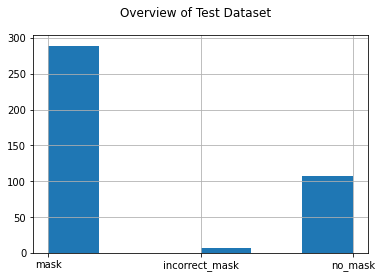

In [ ]:
test_df.labels.hist(bins=6)
plt.suptitle("Overview of Test Dataset")

**Visualize the Training Data Set with Detector 2**

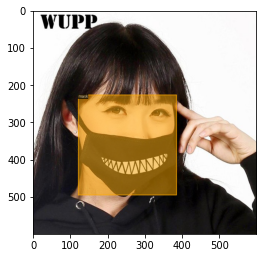

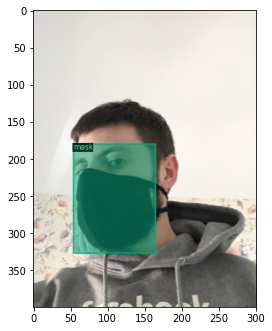

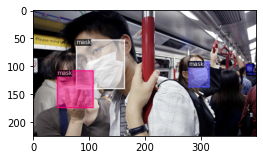

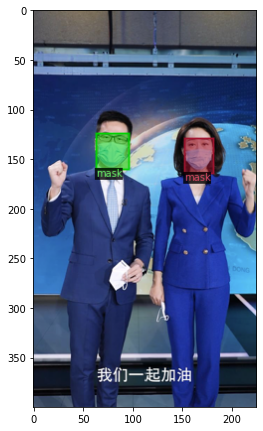

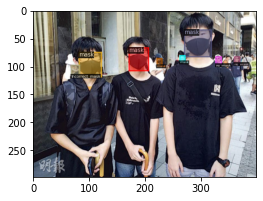

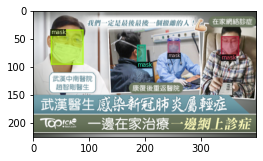

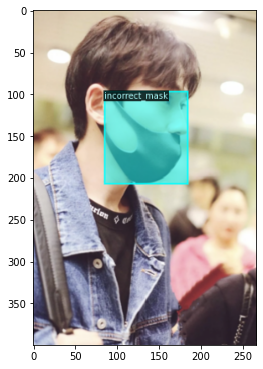

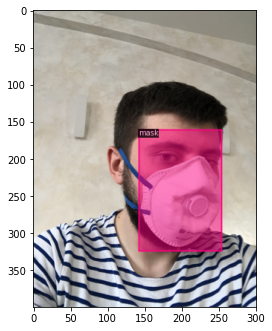

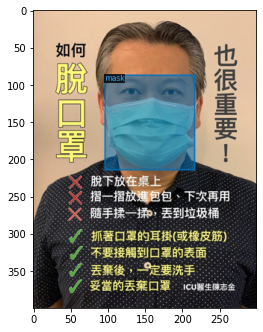

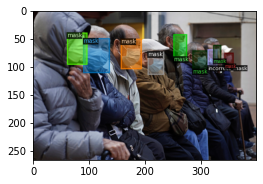

In [ ]:
dataset_dicts = DatasetCatalog.get('data_train')
for d in random.sample(dataset_dicts, 10):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata)
    vis = visualizer.draw_dataset_dict(d)
    plt.figure(figsize = (4, 8))
    plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
    plt.show()

In [ ]:
statement_metadata

Metadata(name='data_train', thing_classes=['no_mask', 'incorrect_mask', 'mask'])

# **MASK RCNN Model 101**

The first model that we chose is Mask RCNN which has the highest performance among the suggested image recognization model in the literature. 
Use the pretrained Mask R



In [ ]:
# These code lines belongs to Reference 2. Link: https://medium.com/@apofeniaco/training-on-detectron2-with-a-validation-set-and-plot-loss-on-it-to-avoid-overfitting-6449418fbf4e

from detectron2.engine.hooks import HookBase
from detectron2.evaluation import inference_context
from detectron2.utils.logger import log_every_n_seconds
from detectron2.data import DatasetMapper, build_detection_test_loader
import detectron2.utils.comm as comm
import torch
import time
import datetime
import logging
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__) #<<<<<<<<<<<<<<<<<<<<
class LossEvalHook(HookBase):
    def __init__(self, eval_period, model, data_loader):
        self._model = model
        self._period = eval_period
        self._data_loader = data_loader
    
    def _do_loss_eval(self):
        # Copying inference_on_dataset from evaluator.py
        total = len(self._data_loader)
        num_warmup = min(5, total - 1)
            
        start_time = time.perf_counter()
        total_compute_time = 0
        losses = []
        for idx, inputs in enumerate(self._data_loader):            
            if idx == num_warmup:
                start_time = time.perf_counter()
                total_compute_time = 0
            start_compute_time = time.perf_counter()
            if torch.cuda.is_available():
                torch.cuda.synchronize()
            total_compute_time += time.perf_counter() - start_compute_time
            iters_after_start = idx + 1 - num_warmup * int(idx >= num_warmup)
            seconds_per_img = total_compute_time / iters_after_start
            if idx >= num_warmup * 2 or seconds_per_img > 5:
                total_seconds_per_img = (time.perf_counter() - start_time) / iters_after_start
                eta = datetime.timedelta(seconds=int(total_seconds_per_img * (total - idx - 1)))
                log_every_n_seconds(
                    logging.INFO,
                    "Loss on Validation  done {}/{}. {:.4f} s / img. ETA={}".format(
                        idx + 1, total, seconds_per_img, str(eta)
                    ),
                    n=5,
                )
            loss_batch = self._get_loss(inputs)
            losses.append(loss_batch)
        mean_loss = np.mean(losses)
        self.trainer.storage.put_scalar('validation_loss', mean_loss)
        comm.synchronize()

        return losses
            
    def _get_loss(self, data):
        # How loss is calculated on train_loop 
        metrics_dict = self._model(data)
        metrics_dict = {
            k: v.detach().cpu().item() if isinstance(v, torch.Tensor) else float(v)
            for k, v in metrics_dict.items()
        }
        total_losses_reduced = sum(loss for loss in metrics_dict.values())
        return total_losses_reduced
        
        
    def after_step(self):
        next_iter = self.trainer.iter + 1
        is_final = next_iter == self.trainer.max_iter
        if is_final or (self._period > 0 and next_iter % self._period == 0):
            self._do_loss_eval()
        self.trainer.storage.put_scalars(timetest=12)
class MyTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
        return COCOEvaluator(dataset_name, cfg, True, output_folder)
                     
    def build_hooks(self):
        hooks = super().build_hooks()
        hooks.insert(-1,LossEvalHook(
            cfg.TEST.EVAL_PERIOD,
            self.model,
            build_detection_test_loader(
                self.cfg,
                self.cfg.DATASETS.TEST[0],
                DatasetMapper(self.cfg,True)
            )
        ))
        return hooks

import json
import matplotlib.pyplot as plt

def load_json_arr(json_path):
    lines = []
    with open(json_path, 'r') as f:
        for line in f:
            lines.append(json.loads(line))
    return lines


In [ ]:
cfg = get_cfg()

cfg.merge_from_file(
  model_zoo.get_config_file(
    "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
  )
)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(
  "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
)
cfg.DATASETS.TRAIN = ("data_train",)
cfg.DATASETS.TEST = ("data_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2500
cfg.SOLVER.STEPS = (1000, 2500)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(classes)
cfg.TEST.EVAL_PERIOD = 100


In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = MyTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/16 23:33:26 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

INFO:fvcore.common.checkpoint:Loading checkpoint from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/139653917/model_final_2d9806.pkl
INFO:iopath.common.file_io:Downloading https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/139653917/model_final_2d9806.pkl ...
INFO:iopath.common.download:Downloading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/139653917/model_final_2d9806.pkl ...
model_final_2d9806.pkl: 431MB [00:16, 26.7MB/s]                           
INFO:iopath.common.download:Successfully downloaded /root/.torch/iopath_cache/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/139653917/model_final_2d9806.pkl. 431414189 bytes.
INFO:iopath.common.file_io:URL https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/139653917/model_final_2d9806.pkl cached in /root/.torch/iopath_cac

[12/16 23:33:49 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python

[12/16 23:34:48 d2.utils.events]:  eta: 2:01:05  iter: 19  total_loss: 2.921  loss_cls: 1.402  loss_box_reg: 0.4683  loss_mask: 0.6901  loss_rpn_cls: 0.3139  loss_rpn_loc: 0.06203  time: 2.9439  data_time: 0.0260  lr: 1.9981e-05  max_mem: 11281M
[12/16 23:35:53 d2.utils.events]:  eta: 2:09:36  iter: 39  total_loss: 2.683  loss_cls: 1.134  loss_box_reg: 0.6024  loss_mask: 0.6542  loss_rpn_cls: 0.1758  loss_rpn_loc: 0.03227  time: 3.1244  data_time: 0.0004  lr: 3.9961e-05  max_mem: 11282M
[12/16 23:36:55 d2.utils.events]:  eta: 2:08:12  iter: 59  total_loss: 2.264  loss_cls: 0.8468  loss_box_reg: 0.7377  loss_mask: 0.6004  loss_rpn_cls: 0.08492  loss_rpn_loc: 0.02003  time: 3.1101  data_time: 0.0004  lr: 5.9941e-05  max_mem: 11282M
[12/16 23:38:01 d2.utils.events]:  eta: 2:08:49  iter: 79  total_loss: 2.144  loss_cls: 0.6504  loss_box_reg: 0.8161  loss_mask: 0.5231  loss_rpn_cls: 0.05312  loss_rpn_loc: 0.03659  time: 3.1613  data_time: 0.0004  lr: 7.9921e-05  max_mem: 11282M
[12/16 23:39

INFO:fvcore.common.checkpoint:Saving checkpoint to ./output/model_final.pth


[12/17 02:08:07 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[12/17 02:08:07 d2.data.common]: Serializing 85 elements to byte tensors and concatenating them all ...
[12/17 02:08:07 d2.data.common]: Serialized dataset takes 0.05 MiB
WARNING [12/17 02:08:07 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[12/17 02:08:07 d2.evaluation.evaluator]: Start inference on 85 images
[12/17 02:08:11 d2.evaluation.evaluator]: Inference done 11/85. 0.2802 s / img. ETA=0:00:20
[12/17 02:08:16 d2.evaluation.evaluator]: Inference done 29/85. 0.2762 s / img. ETA=0:00:15
[12/17 02:08:21 d2.evaluation.evaluator]: Inference done 47/85. 0.2772 s / img. ETA=0:00:10
[12/17 02:08:26 d2.evaluation.evaluator]: Inference done 65/85. 0.2775 s / img. ETA=0:00:05
[12/17 02:08:31 d2.evaluation.evaluator]: Inference do

**Save the checkpoints**

In [ ]:
torch.save(trainer.model, 'checkpoint.pth')

In [ ]:
!cp output/* drive/MyDrive/CompetitionDL/output/
!cp  checkpoint.pth drive/MyDrive/CompetitionDL/

cp: -r not specified; omitting directory 'output/inference'
output/inference
output/inference/*


# **Learning Curves**

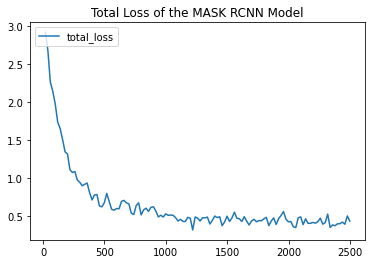

In [ ]:
experiment_metrics = load_json_arr('output/metrics.json')
total_it, total_loss = [], []
for x in experiment_metrics:
  if 'total_loss' in x :
     total_it.append(x['iteration'])
     total_loss.append(x['total_loss'] )
plt.plot(total_it,total_loss)
plt.title("Total Loss of the MASK RCNN Model")
plt.legend(['total_loss'], loc='upper left')
plt.show()

As you can see the figure above, total loss of the model is stable and less than 0.5 after 1000 iteration.

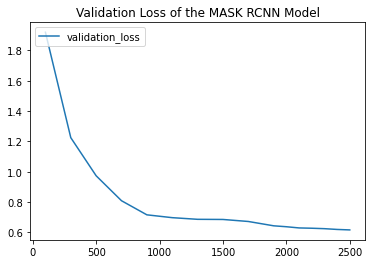

In [ ]:
total_it, val_loss =[], []

for x in experiment_metrics:
  if 'validation_loss' in x :
     total_it.append(x['iteration'])
     val_loss.append(x['validation_loss'] )
plt.plot(total_it,val_loss)
plt.title("Validation Loss of the MASK RCNN Model")
plt.legend(['validation_loss'], loc='upper left')
plt.show()


The validation loss of the model has started from almost 0.75 in the 500th iterations, and it has dropped to approximately 0.60 throughout 2500 iterations. Additionally, we test the validation data after each 100 iteration.

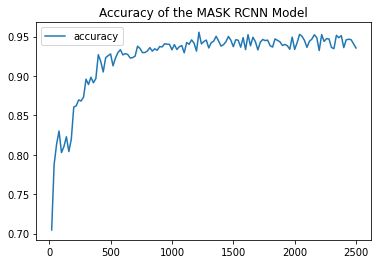

In [ ]:
experiment_metrics = load_json_arr('output/metrics.json')
total_it, accuracy =[], []

for x in experiment_metrics:
  if 'mask_rcnn/accuracy' in x :
     total_it.append(x['iteration'])
     accuracy.append(x['mask_rcnn/accuracy'] )
plt.plot(total_it,accuracy)
plt.title("Accuracy of the MASK RCNN Model")
plt.legend(['accuracy'], loc='upper left')
plt.show()

As you can see the figure above, the accuray of the mask rcnn model has increased, and it has been a small fluactuation after 1000 iteration. The accuracy of the model has been almost 0.95 at the end of the model training. This accuracy is quite good.

**<font color="purple">Discussion of the Mask RNN Results :</font>**

**Evaluation of the Mask RNN Model**



1.   Use cocoevaluate to evaluate the public test dataset.



In [ ]:
evaluator = COCOEvaluator("data_test", cfg, False, output_dir="./coco/")
test_loader = build_detection_test_loader(cfg, "data_test")
evaluate = inference_on_dataset(trainer.model, test_loader, evaluator)


WARNING [12/17 02:10:18 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[12/17 02:10:18 d2.evaluation.coco_evaluation]: 'data_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[12/17 02:10:18 d2.data.datasets.coco]: Converting annotations of dataset 'data_test' to COCO format ...)
[12/17 02:10:18 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[12/17 02:10:18 d2.data.datasets.coco]: Conversion finished, #images: 85, #annotations: 404
[12/17 02:10:18 d2.data.datasets.coco]: Caching COCO format annotations at './coco/data_test_coco_format.json' ...
[12/17 02:10:18 d2.data.build]: Distribution of instances among all 3 categories:
|  category  | #instances   |   category    | #instances   |  category  | #instances   |
|:----------:|:-------------|:-------------:|:-------------|:----------:|:-------------|
|  no_mask   | 108          | 

INFO:fvcore.common.checkpoint:Loading checkpoint from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/139653917/model_final_2d9806.pkl
INFO:fvcore.common.checkpoint:Reading a file from 'Detectron2 Model Zoo'
INFO:fvcore.common.checkpoint:Some model parameters or buffers are not found in the checkpoint:
  roi_heads.box_predictor.cls_score.{weight, bias}
  roi_heads.mask_head.predictor.{weight, bias}
  roi_heads.box_predictor.bbox_pred.{weight, bias}


**<font color="purple">Discussion:</font>**
 
For the 85 images, the Average Recall for large is 0.829, and the average precision values of mask and incorrect mask labels are 65.45 and 58.993, respectively. As you can see from the evaluation results, the average precision and recall has decreased when box area is small. The results of these low values are shown below  under the coco mAP result section.
These small boxes cause the misclassification problem on the model.

# **COCO mAP Functions**

In [ ]:
!pip install mean_average_precision
!pip install --upgrade git+https://github.com/bes-dev/mean_average_precision.git

The "**get_preds_and_gt(im)**" function constructs the gt and preds for a given image.




In [ ]:
def get_preds_and_gt(img, d_dict, predictor):
  """
  im : image 
  returns:
        outputs : prediction result as preds
        gt: outputs_gt
  """

  output = predictor(img)
  instances = output["instances"].to("cpu")
  boxes = instances.pred_boxes.tensor.numpy()
  categories = instances.pred_classes.numpy()
  scores = instances.scores.numpy()
  outputs, gt, bbox_list = [], [], []

  for a in d_dict['annotations']:
    bbox_list.append(a['bbox'])

  for i, score in enumerate(list(scores)):
    output_line =list(boxes[i])
    output_line.append(list(categories)[i])
    output_line.append(score)
    outputs.append(output_line)

  for i, bbox in enumerate(bbox_list):
    gt_line = bbox
    category_id = d_dict["annotations"][i]['category_id']
    gt_line.append(category_id)
    gt_line.append(0)
    gt_line.append(0)
    gt.append(gt_line)
    
  return np.array(outputs), np.array(gt), categories


**COCO mAP function**

We developed a custom COCO mAP function evaluate the public test dataset.

In [ ]:
import numpy as np
from mean_average_precision import MetricBuilder
# These codes shared on moodle pages of Competitive Programming with DL
def get_COCO_mAP(metric_fn):
  return metric_fn.value(iou_thresholds=np.arange(0.5, 1.0, 0.05), recall_thresholds=np.arange(0., 1.01, 0.01), mpolicy='soft')['mAP']
# This methods adapts the prediction and ground truth data to allow a
# correct mAP calculation (from the mean-average-precision library)
def calc_mAP_metric(preds, gt, minScore=0.0):
    """
      preds - predictions in mAP format
      gt    - ground truth in mAP format

      preds format: [ [xmin, ymin, xmax, ymax, class_id, confidence], ... ]
      gt format:    [ [xmin, ymin, xmax, ymax, class_id, difficult, crowd], ... ]

    """
    # Filter out all values smaller than minScore

    preds = preds[preds[:,5] > minScore]
    # First check which classes occur in our prediction & gt data
    classes = np.union1d(np.unique(preds[:,4]), np.unique(gt[:,4]))

    # The MeanAveragePrecision2D calculator expect class from 0 to num_classes-1.
    # Thus, we have to change the classes in our dataset to fit this requirement.
    # The result of the calculation is not influenced by the actual class, as 
    # long as the changes in class are the same for pred and gt.

    # Thus get the smalles class
    minC = np.amin(classes)

    # Adapt the class column of preds and gt by susbtracting the smalles class
    subArrayPred = np.ones(preds.shape[0]) * minC
    subArrayGt = np.ones(gt.shape[0]) * minC
    preds[:,4] = preds[:,4]- subArrayPred
    gt[:,4] = gt[:,4] - subArrayGt

    # To ensure correct mAP calculation create a MeanAveragePrecision2D 
    # instance ONLY with the number of occuring classes in our dataset
    numC = len(classes)
    metric = MetricBuilder.build_evaluation_metric("map_2d", async_mode=True, num_classes=numC)

    # Add the adapted data set and calc the COCO mAP value
    metric.add(preds, gt)
    mAP = get_COCO_mAP(metric)

    # Undo the substraction
    preds[:,4] =  preds[:,4]  + subArrayPred
    gt[:,4] = gt[:,4] + subArrayGt

    return mAP

The COCO mAP Evaluation function calculates the PASCAL VOC metric, PASCAL VOC metric at all points, and COCO metric

In [ ]:
def mAP_of_preds(output_preds, output_gt):

  # create metric_fn
  metric_fn = MetricBuilder.build_evaluation_metric("map_2d", async_mode=True, num_classes=3)

  for i in range(len(output_preds)):
      metric_fn.add(preds, gt)

  # compute PASCAL VOC metric
  voc_pascal_map =metric_fn.value(iou_thresholds=0.5, recall_thresholds=np.arange(0., 1.1, 0.1))['mAP']

  # compute PASCAL VOC metric at the all points
  voc_pascal_map_all = metric_fn.value(iou_thresholds=0.5)['mAP']

  # compute metric COCO metric
  coco_map = metric_fn.value(iou_thresholds=np.arange(0.5, 1.0, 0.05), recall_thresholds=np.arange(0., 1.01, 0.01), mpolicy='soft')['mAP']
  return voc_pascal_map,voc_pascal_map_all, coco_map

We are testing the test data set using COCO mAP, and then save the results as json file. Lastly copy the file to drive.

Evaluate the all public test data using custom COCO mAP functions ("calc_mAP_metric" and mAP_of_preds), and then save the result to json file

In [ ]:
import random
from detectron2.utils.visualizer import Visualizer
import json

def evaluate_model(predictor, data, result_file):
  pics_wrong = []
  dataset_dicts = DatasetCatalog.get(data)

  test_metric = MetricBuilder.build_evaluation_metric("map_2d", async_mode=True, num_classes=3)
  
  f = open(result_file, "x")
  for d in dataset_dicts:

    with open(result_file, mode='a', encoding='utf-8') as feedsjson:
      img = cv2.imread(d["file_name"])
      preds, gt, pred_classes = get_preds_and_gt(img,d, predictor)
      if len(preds) == 0 or len(gt) == 0:# when preds or gt is empty list, coco_map will be 0.0 and calc_mAP_metric has a problem here
        voc_pascal_map, voc_pascal_map_all, coco_map = mAP_of_preds(preds, gt)
        pics_wrong.append(d["file_name"])
      else:
        coco_map = calc_mAP_metric(preds, gt)
      result_line = {'file_name':d["file_name"],'coco_map':str(coco_map), 'preds': str(pred_classes)}
      feedsjson.write(json.dumps(result_line, ensure_ascii=False, indent=4))
      feedsjson.write(",")
      feedsjson.close()
  return pics_wrong


# **COCO mAP for the Evaluation of the Public Test Dataset**

**This part is regarding the loading a model which has been already trained. If you dont train the model, please run !cp line. Otherwise Run these lines below directly**

In [ ]:
cfg = get_cfg()
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
#!cp drive/MyDrive/CompetitionDL/output/* output/

In [ ]:
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATALOADER.NUM_WORKERS = 4
cfg.DATASETS.TEST = ("data_test", )
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85  # set the testing threshold for this model
predictor = DefaultPredictor(cfg)

INFO:fvcore.common.checkpoint:Loading checkpoint from ./output/model_final.pth


In [ ]:
pics_wrong = evaluate_model(predictor, "data_test", "test_result.json")

**<font color="purple">Discussion of Evaluation Results:</font>**

**The COCO mAP of the images below is 0.0.**


=======================Result===============================
                   name labels  xmin  ymin  xmax  ymax  height  width
39  maksssksksss106.png   mask   154    51   423   391   399.0  600.0


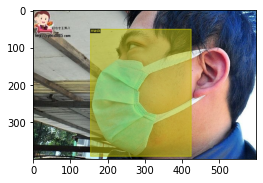

=======================Result===============================
                     name labels  xmin  ymin  xmax  ymax  height  width
1035  maksssksksss292.png   mask   189    88   220   125   300.0  400.0
1036  maksssksksss292.png   mask   144    65   178   109   300.0  400.0


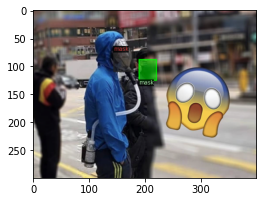

In [ ]:
dataset_dicts = DatasetCatalog.get("data_test")
for i, img_file in enumerate(pics_wrong):
  for d in dataset_dicts:
    if d["file_name"] == img_file:
      print("=======================Result===============================")
      print(test_df[test_df.name== d["file_name"][12:]])
      img = cv2.imread(d["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata)
      vis = visualizer.draw_dataset_dict(d)
      plt.figure(figsize = (4, 8))
      plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
      plt.show()


The prediction of the label of the box for the image above is empty, which means our model could not do any prediction for this image. The mask in the second image is  a bit strange, so the model might not be familiat with it.

**Save the test results to drive**

You can change the folder here.

In [ ]:
!cp test_result.json drive/MyDrive/CompetitionDL/

# **Visualize the Result**

=======================Result===============================
COCO mAP: 0.9


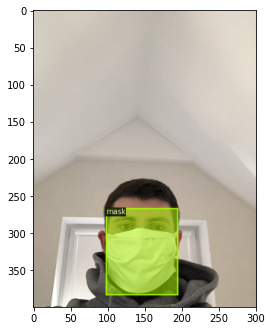

=======================Result===============================
COCO mAP: 0.8948019


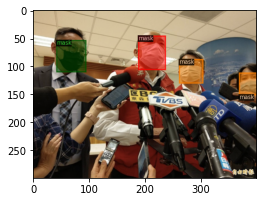

=======================Result===============================
COCO mAP: 0.0


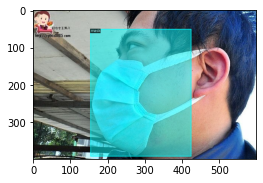

=======================Result===============================
COCO mAP: 0.29016632


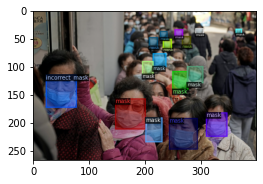

=======================Result===============================
COCO mAP: 0.4


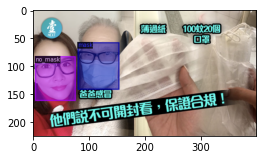

=======================Result===============================
COCO mAP: 0.05


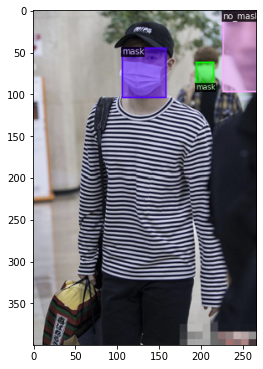

=======================Result===============================
COCO mAP: 0.8252476


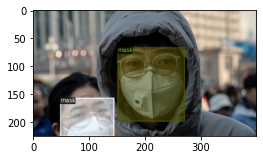

=======================Result===============================
COCO mAP: 0.8


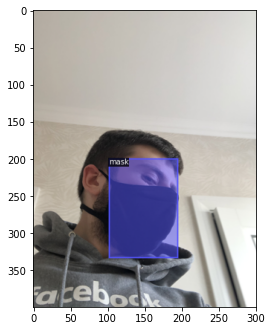

=======================Result===============================
COCO mAP: 0.9


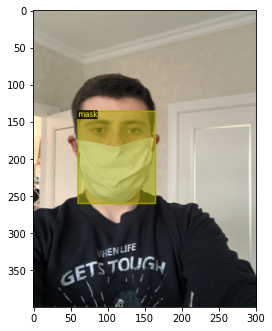

=======================Result===============================
COCO mAP: 0.4


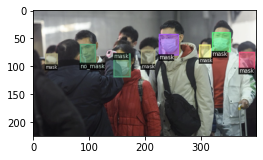

=======================Result===============================
COCO mAP: 0.7009901


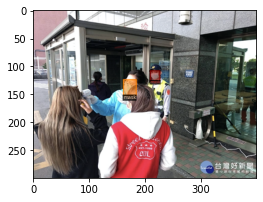

=======================Result===============================
COCO mAP: 0.719802


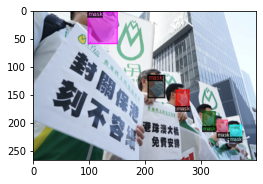

=======================Result===============================
COCO mAP: 0.62054455


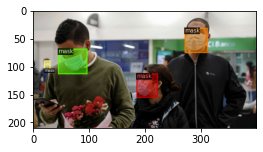

=======================Result===============================
COCO mAP: 0.8


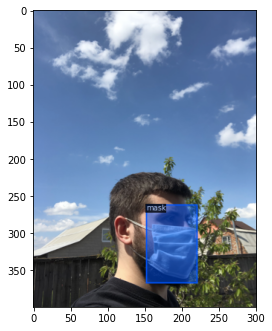

=======================Result===============================
COCO mAP: 0.6860993


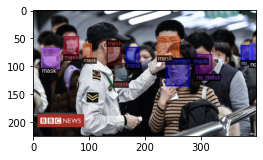

=======================Result===============================
COCO mAP: 0.2019802


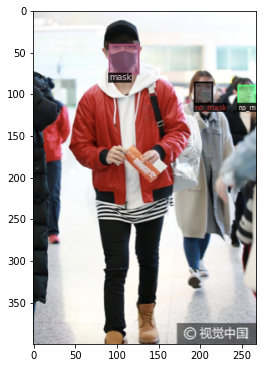

=======================Result===============================
COCO mAP: 0.85049504


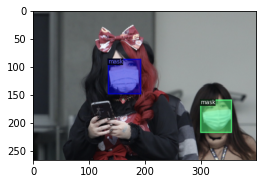

=======================Result===============================
COCO mAP: 0.5947855


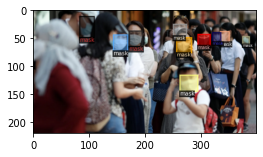

=======================Result===============================
COCO mAP: 0.6


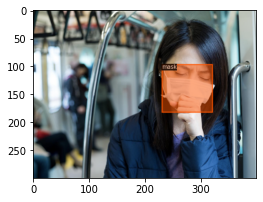

=======================Result===============================
COCO mAP: 0.2019802


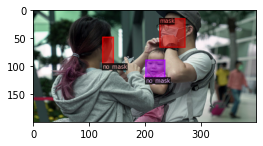

=======================Result===============================
COCO mAP: 0.8


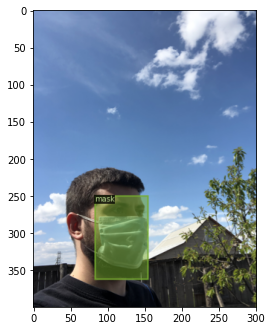

=======================Result===============================
COCO mAP: 0.8386138


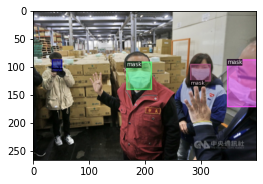

=======================Result===============================
COCO mAP: 0.7


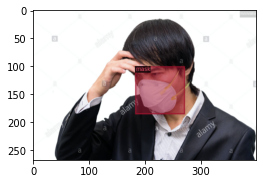

=======================Result===============================
COCO mAP: 0.0


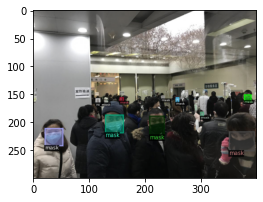

=======================Result===============================
COCO mAP: 0.5703874


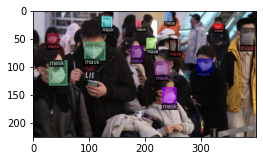

=======================Result===============================
COCO mAP: 0.85049504


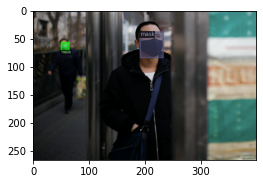

=======================Result===============================
COCO mAP: 0.16758022


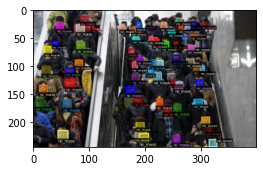

=======================Result===============================
COCO mAP: 0.9


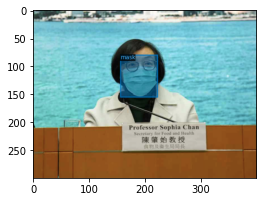

=======================Result===============================
COCO mAP: 0.9


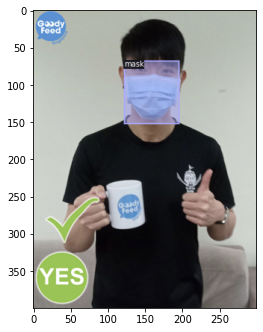

=======================Result===============================
COCO mAP: 0.7105611


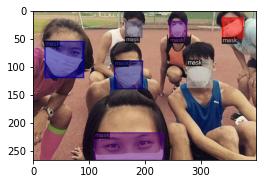

=======================Result===============================
COCO mAP: 0.0


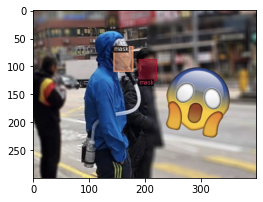

=======================Result===============================
COCO mAP: 0.8252476


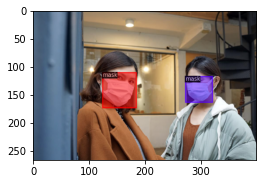

=======================Result===============================
COCO mAP: 0.35


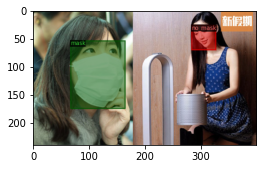

=======================Result===============================
COCO mAP: 0.16138613


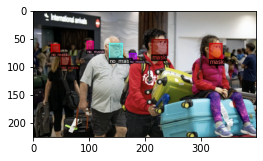

=======================Result===============================
COCO mAP: 0.8


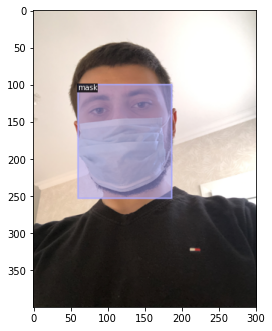

=======================Result===============================
COCO mAP: 0.4


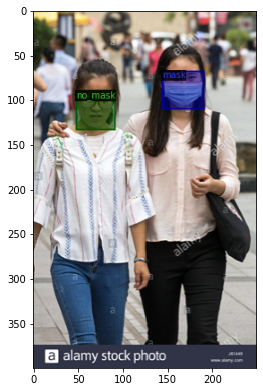

=======================Result===============================
COCO mAP: 0.7554456


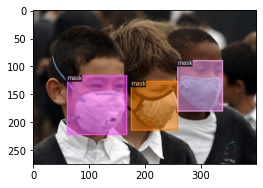

=======================Result===============================
COCO mAP: 0.45


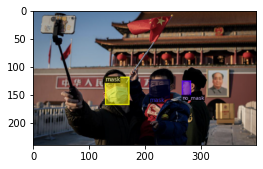

=======================Result===============================
COCO mAP: 0.9


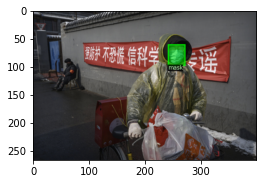

=======================Result===============================
COCO mAP: 0.8


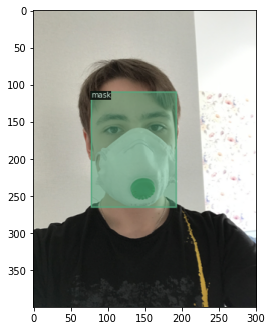

=======================Result===============================
COCO mAP: 0.50874585


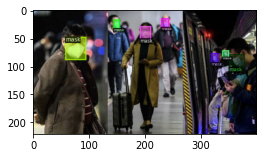

=======================Result===============================
COCO mAP: 0.22722773


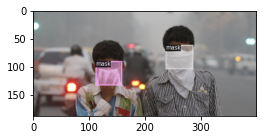

=======================Result===============================
COCO mAP: 0.9


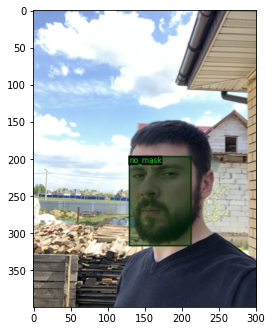

=======================Result===============================
COCO mAP: 0.0


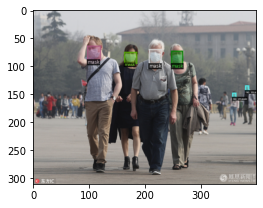

=======================Result===============================
COCO mAP: 0.4


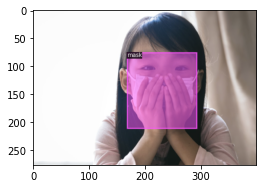

=======================Result===============================
COCO mAP: 0.9


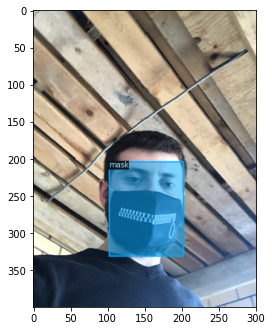

=======================Result===============================
COCO mAP: 0.75396043


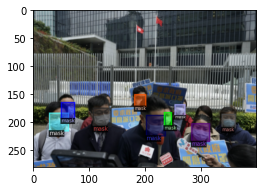

=======================Result===============================
COCO mAP: 0.1450495


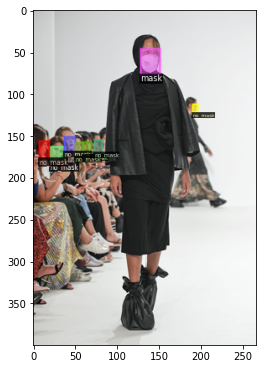

=======================Result===============================
COCO mAP: 0.9


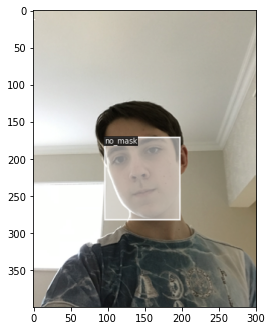

=======================Result===============================
COCO mAP: 0.8


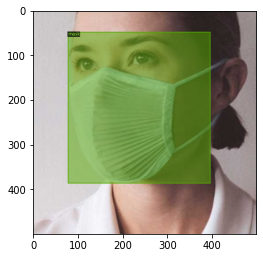

=======================Result===============================
COCO mAP: 0.8168317


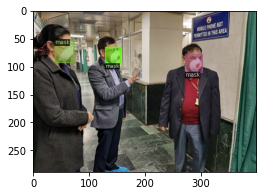

=======================Result===============================
COCO mAP: 0.76039606


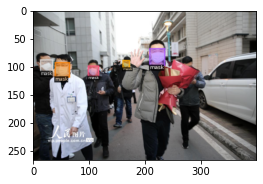

=======================Result===============================
COCO mAP: 0.8


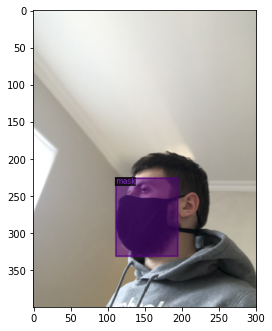

=======================Result===============================
COCO mAP: 0.28217822


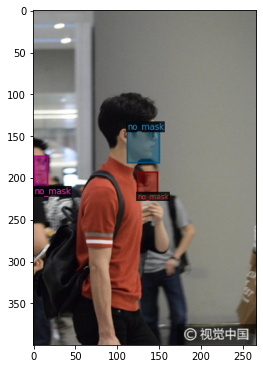

=======================Result===============================
COCO mAP: 0.15


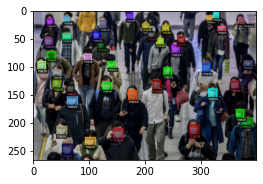

=======================Result===============================
COCO mAP: 0.9


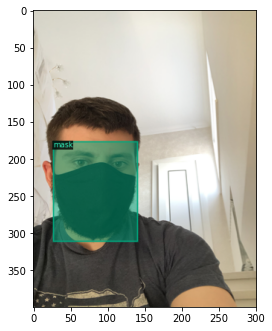

=======================Result===============================
COCO mAP: 0.8


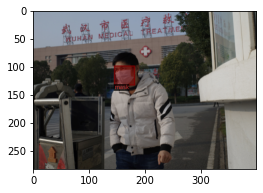

=======================Result===============================
COCO mAP: 0.59665835


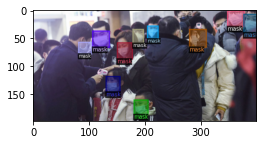

=======================Result===============================
COCO mAP: 0.8


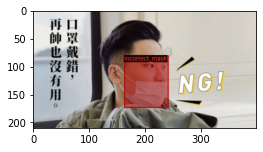

=======================Result===============================
COCO mAP: 0.9


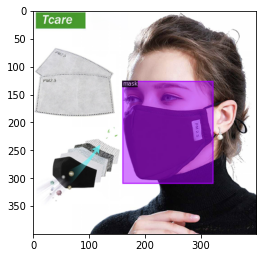

=======================Result===============================
COCO mAP: 0.9


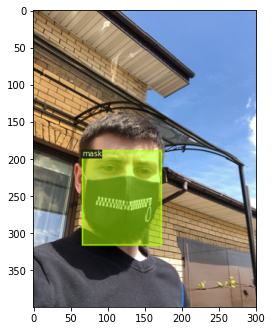

=======================Result===============================
COCO mAP: 1.0


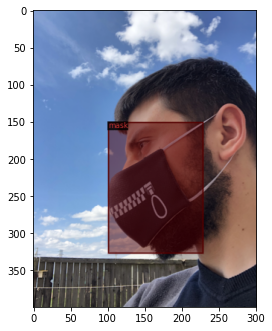

=======================Result===============================
COCO mAP: 0.7336634


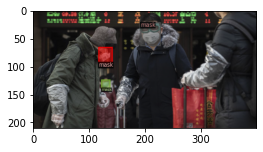

=======================Result===============================
COCO mAP: 0.9


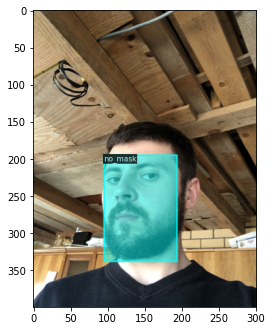

=======================Result===============================
COCO mAP: 0.9


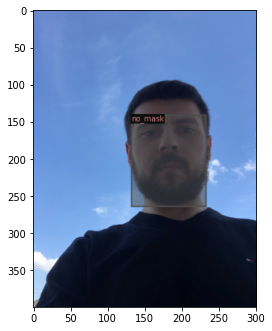

=======================Result===============================
COCO mAP: 0.74898636


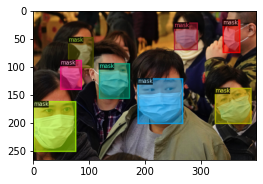

=======================Result===============================
COCO mAP: 0.69372934


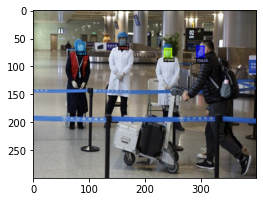

=======================Result===============================
COCO mAP: 0.4


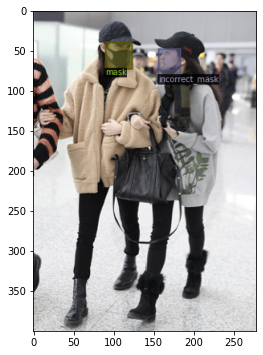

=======================Result===============================
COCO mAP: 0.0


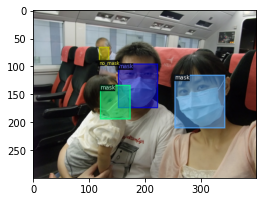

=======================Result===============================
COCO mAP: 0.23354551


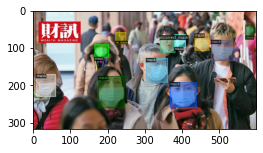

=======================Result===============================
COCO mAP: 0.9


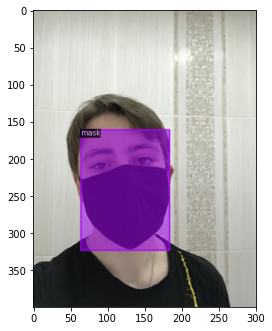

=======================Result===============================
COCO mAP: 0.7666667


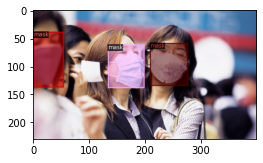

=======================Result===============================
COCO mAP: 0.29414192


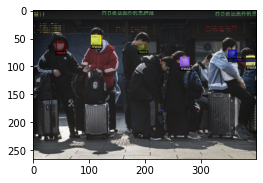

=======================Result===============================
COCO mAP: 0.32524753


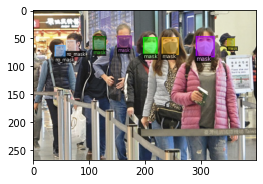

=======================Result===============================
COCO mAP: 0.39535126


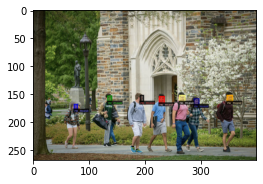

=======================Result===============================
COCO mAP: 0.15


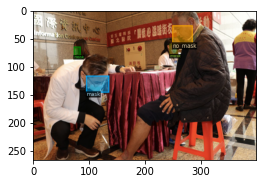

=======================Result===============================
COCO mAP: 0.8


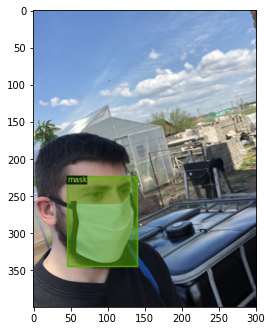

=======================Result===============================
COCO mAP: 0.45


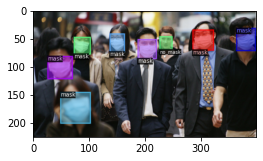

=======================Result===============================
COCO mAP: 0.7151815


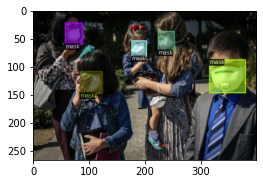

=======================Result===============================
COCO mAP: 0.9


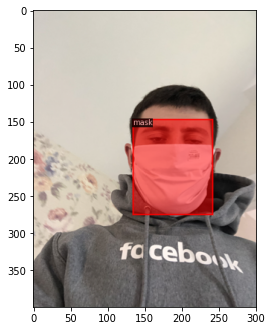

=======================Result===============================
COCO mAP: 1.0


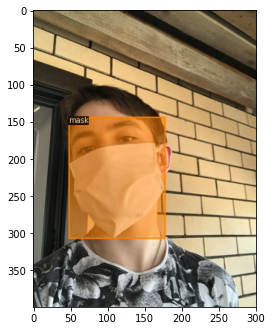

=======================Result===============================
COCO mAP: 0.9


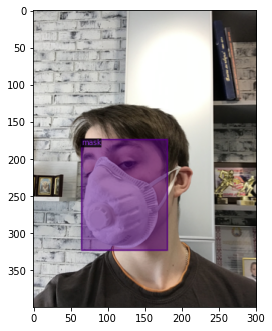

=======================Result===============================
COCO mAP: 0.4


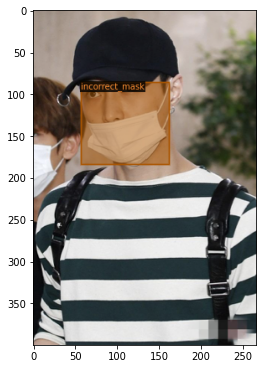

=======================Result===============================
COCO mAP: 0.8


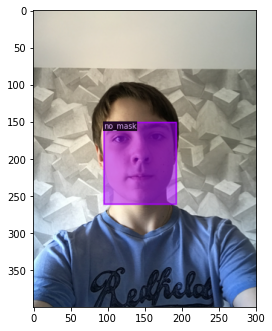

=======================Result===============================
COCO mAP: 0.0


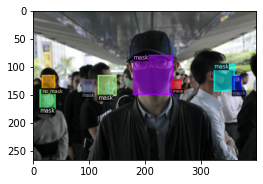

In [ ]:
with open('test_result.json', 'r') as content_file:
    content = content_file.read()

for e in eval(content):
  for d in dataset_dicts:
    if d["file_name"] == e['file_name']:
      print("=======================Result===============================")
      print("COCO mAP: {0}".format(e['coco_map']))
      img = cv2.imread(d["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata)
      vis = visualizer.draw_dataset_dict(d)
      plt.figure(figsize = (4, 8))
      plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
      plt.show()

Check  the images which have the COCO mAP = 0.0  

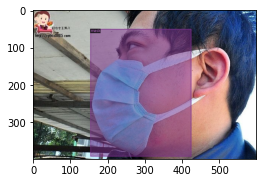

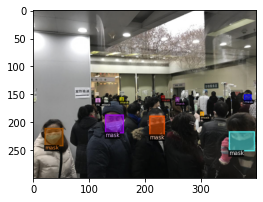

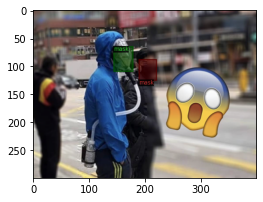

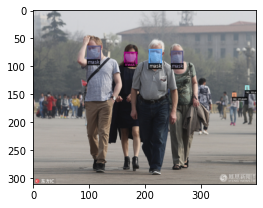

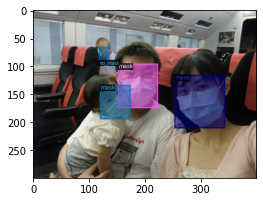

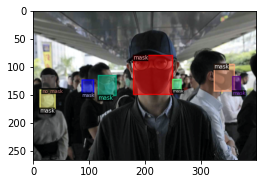

In [ ]:
for e in eval(content):
  for d in dataset_dicts:
    if d["file_name"] == e['file_name']:
      if e['coco_map'] == "0.0":
         img = cv2.imread(d["file_name"])
         visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata)
         vis = visualizer.draw_dataset_dict(d)
         plt.figure(figsize = (4, 8))
         plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
         plt.show()


**<font color="purple"> Discussion:</font>**

Apart from the results of the predictor for a given image are an empty list, we have COCO mAP=0.0 for 4 images, and because of the small size of some boxes, COCO mAP has decreased. If we increase the size of the boxes, the result of COCO mAP for the images will improve.

# **Use these lines for private test dataset**

Run the sections that we give the names below before running this part.
* Installation
* Libraries
* Load Data and Split it to train and test set
* COCO mAP Functions then here

If you want to use a new data_set instead of achive.zip

In [ ]:
private_path_cpy ="mask"# write your folder name here

coordinates, name, labels, size = gen_list(private_path_cpy)
private_df = DataFrame()
initialize_frame(private_df,name, labels)
assign_value_dataframe(private_df, coordinates)


If you want to use a dataset from archive.zip, customize the lines below for yourself.
Maybe you should change the DataSetSplit.cv for private dataset

In [ ]:
datasetSplit

In [ ]:
private_test_files = datasetSplit["0"][5][2:-2].replace("', '", ",").split(',')
private_test_df = df[df.name.isin(private_test_files)]

Register the private test dataset 

In [ ]:
# Register the private_test_set
DatasetCatalog.register("data_private_test", lambda:my_dataset_function(private_test_df, classes))
MetadataCatalog.get("data_private_test" ).set(thing_classes=classes)

Load the model

In [ ]:
!cp drive/MyDrive/CompetitionDL/output ./

In [ ]:
# Configuration setup for testing
cfg1 = get_cfg()
cfg1.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg1.DATALOADER.NUM_WORKERS = 4
cfg1.DATASETS.TEST = ("data_private_test", )
cfg1.MODEL.ROI_HEADS.NUM_CLASSES = 3
cfg1.MODEL.WEIGHTS = os.path.join(cfg1.OUTPUT_DIR, "model_final.pth")
cfg1.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85  # set the testing threshold for this model

predictor1 = DefaultPredictor(cfg1)

**COCO mAP Evaluation for private test dataset**

In [ ]:
evaluate_model(predictor1, "data_private_test", "private_test_result.json")

* Show your results on "private_test_result.json"

In [ ]:
with open('private_test_result.json', 'r') as content_file:
    content = content_file.read()

for e in eval(content):
  for d in dataset_dicts:
    if d["file_name"] == e['file_name']:
      print("=======================Result===============================")
      print("COCO mAP: {0}".format(e['coco_map']))
      img = cv2.imread(d["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata)
      vis = visualizer.draw_dataset_dict(d)
      plt.figure(figsize = (4, 8))
      plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
      plt.show()

# **The ideas to improve the performance of the model**


1.  Apply the data augmentation to resize the boxes and images
2.   Flip the boxes using data augmentation

**Note:**
The model, mask rcnn 110, has already applied resize for the images according to the lines below from the model training step. As a result, the model applies data augmentation techniques like random flip and Resize.

```
 [DatasetMapper] Augmentations used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[12/15 22:11:37 d2.data.build]: Using training sampler TrainingSampler
```





In conclusion, unfortunately, our model could not predict the label of the boxes which have a small size. This problem can be solved using data augmentation for the size of the boxes.

# **Data Augmentation**

We applied the RandomContrast and RandomBrightness to the images  on the training.

In [ ]:
import os
import torch

import detectron2.data.transforms as T
import detectron2.utils.comm as comm
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.config import get_cfg
from detectron2.data import DatasetMapper, MetadataCatalog, build_detection_train_loader
from detectron2.engine import DefaultTrainer, default_argument_parser, default_setup, launch
from detectron2.evaluation import CityscapesSemSegEvaluator, DatasetEvaluators, SemSegEvaluator
from detectron2.projects.deeplab import add_deeplab_config, build_lr_scheduler
import copy 
from detectron2.data import detection_utils as utils

class Trainer(DefaultTrainer):
    """
    We use the "DefaultTrainer" which contains a number pre-defined logic for
    standard training workflow. They may not work for you, especially if you
    are working on a new research project. In that case you can use the cleaner
    "SimpleTrainer", or write your own training loop.
    """

    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
        return COCOEvaluator(dataset_name, cfg, True, output_folder)
                     
    def build_hooks(self):
        hooks = super().build_hooks()
        hooks.insert(-1,LossEvalHook(
            cfg.TEST.EVAL_PERIOD,
            self.model,
            build_detection_test_loader(
                self.cfg,
                self.cfg.DATASETS.TEST[0],
                DatasetMapper(self.cfg,True)
            )
        ))
        return hooks
    def build_train_loader(cls, cfg):
        return build_detection_train_loader(cfg, mapper=DatasetMapper(cfg, is_train=True, augmentations=[
                                                                                                         T.RandomContrast(0.8, 3),
                                                                                                         T.RandomBrightness(0.8, 1.6)]))

    @classmethod
    def build_lr_scheduler(cls, cfg, optimizer):
        """
        It now calls :func:`detectron2.solver.build_lr_scheduler`.
        Overwrite it if you'd like a different scheduler.
        """
        return build_lr_scheduler(cfg, optimizer)


In [ ]:
cfg = get_cfg()

cfg.merge_from_file(
  model_zoo.get_config_file(
    "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
  )
)

cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(
  "COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"
)
cfg.DATASETS.TRAIN = ("data_train",)
cfg.DATASETS.TEST = ("data_val",)
cfg.DATALOADER.NUM_WORKERS = 4
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 2500
cfg.SOLVER.STEPS = (1000, 2500)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = len(classes)
cfg.TEST.EVAL_PERIOD = 100


In [ ]:
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

trainer = Trainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/16 21:39:19 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

INFO:fvcore.common.checkpoint:Loading checkpoint from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x/139653917/model_final_2d9806.pkl
INFO:fvcore.common.checkpoint:Reading a file from 'Detectron2 Model Zoo'
INFO:fvcore.common.checkpoint:Some model parameters or buffers are not found in the checkpoint:
  roi_heads.box_predictor.bbox_pred.{weight, bias}
  roi_heads.mask_head.predictor.{bias, weight}
  roi_heads.box_predictor.cls_score.{bias, weight}


[12/16 21:39:21 d2.engine.train_loop]: Starting training from iteration 0
[12/16 21:39:32 d2.utils.events]:  eta: 0:22:19  iter: 19  total_loss: 3.083  loss_cls: 1.441  loss_box_reg: 0.4535  loss_mask: 0.6887  loss_rpn_cls: 0.3493  loss_rpn_loc: 0.1504  time: 0.5478  data_time: 0.0201  lr: 1.9981e-05  max_mem: 13501M
[12/16 21:39:44 d2.utils.events]:  eta: 0:23:05  iter: 39  total_loss: 2.738  loss_cls: 1.192  loss_box_reg: 0.5505  loss_mask: 0.6634  loss_rpn_cls: 0.233  loss_rpn_loc: 0.08777  time: 0.5822  data_time: 0.0003  lr: 3.9961e-05  max_mem: 13501M
[12/16 21:39:57 d2.utils.events]:  eta: 0:22:59  iter: 59  total_loss: 2.373  loss_cls: 0.8323  loss_box_reg: 0.5871  loss_mask: 0.6166  loss_rpn_cls: 0.2162  loss_rpn_loc: 0.1018  time: 0.5955  data_time: 0.0005  lr: 5.9941e-05  max_mem: 13501M
[12/16 21:40:09 d2.utils.events]:  eta: 0:23:08  iter: 79  total_loss: 2.215  loss_cls: 0.6785  loss_box_reg: 0.689  loss_mask: 0.5623  loss_rpn_cls: 0.1955  loss_rpn_loc: 0.0496  time: 0.59

INFO:fvcore.common.checkpoint:Saving checkpoint to ./output/model_final.pth


[12/16 22:23:27 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[12/16 22:23:27 d2.data.common]: Serializing 85 elements to byte tensors and concatenating them all ...
[12/16 22:23:27 d2.data.common]: Serialized dataset takes 0.05 MiB
WARNING [12/16 22:23:27 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[12/16 22:23:27 d2.evaluation.evaluator]: Start inference on 85 images
[12/16 22:23:30 d2.evaluation.evaluator]: Inference done 11/85. 0.2829 s / img. ETA=0:00:21
[12/16 22:23:36 d2.evaluation.evaluator]: Inference done 29/85. 0.2792 s / img. ETA=0:00:15
[12/16 22:23:41 d2.evaluation.evaluator]: Inference done 47/85. 0.2801 s / img. ETA=0:00:10
[12/16 22:23:46 d2.evaluation.evaluator]: Inference done 65/85. 0.2806 s / img. ETA=0:00:05
[12/16 22:23:51 d2.evaluation.evaluator]: Inference do

Save the model to Drive Folder

In [ ]:
!cp output/* drive/MyDrive/CompetitionDL/output_2/

cp: -r not specified; omitting directory 'output/inference'


In [ ]:
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATALOADER.NUM_WORKERS = 4
cfg.DATASETS.TEST = ("data_test", )
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85  # set the testing threshold for this model
predictor = DefaultPredictor(cfg)

INFO:fvcore.common.checkpoint:Loading checkpoint from output2/model_final.pth


In [ ]:
evaluator = COCOEvaluator("data_test", cfg, False, output_dir="./coco/")
test_loader = build_detection_test_loader(cfg, "data_test")
evaluate = inference_on_dataset(trainer.model, test_loader, evaluator)


WARNING [12/16 22:29:46 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass tasks in directly
[12/16 22:29:46 d2.evaluation.coco_evaluation]: 'data_test' is not registered by `register_coco_instances`. Therefore trying to convert it to COCO format ...
[12/16 22:29:46 d2.data.datasets.coco]: Converting annotations of dataset 'data_test' to COCO format ...)
[12/16 22:29:46 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[12/16 22:29:46 d2.data.datasets.coco]: Conversion finished, #images: 85, #annotations: 404
[12/16 22:29:46 d2.data.datasets.coco]: Caching COCO format annotations at './coco/data_test_coco_format.json' ...
[12/16 22:29:47 d2.data.build]: Distribution of instances among all 3 categories:
|  category  | #instances   |   category    | #instances   |  category  | #instances   |
|:----------:|:-------------|:-------------:|:-------------|:----------:|:-------------|
|  no_mask   | 108          | 

In [ ]:
pics_wrong = evaluate_model(predictor, "data_test", "aug_test_result.json")

The code above shows the images that has empty list on prediction results.

=======================Result===============================
                   name labels  xmin  ymin  xmax  ymax  height  width
39  maksssksksss106.png   mask   154    51   423   391   399.0  600.0


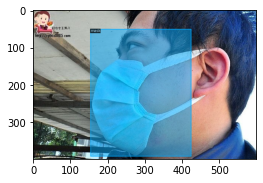

=======================Result===============================
                     name   labels  xmin  ymin  xmax  ymax  height  width
1481  maksssksksss379.png  no_mask   129   197   212   317   400.0  301.0


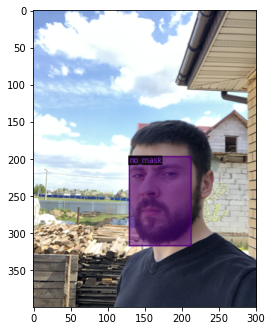

=======================Result===============================
                     name   labels  xmin  ymin  xmax  ymax  height  width
1680  maksssksksss420.png  no_mask    96   171   197   282   400.0  301.0


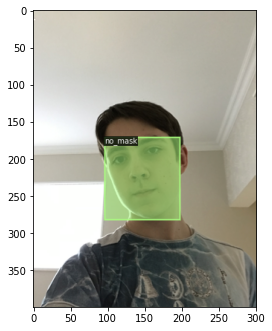

=======================Result===============================
                     name   labels  xmin  ymin  xmax  ymax  height  width
2880  maksssksksss624.png  no_mask    95   195   193   338   400.0  301.0


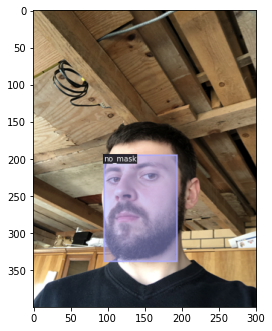

=======================Result===============================
                     name   labels  xmin  ymin  xmax  ymax  height  width
3028  maksssksksss660.png  no_mask   132   141   232   264   400.0  301.0


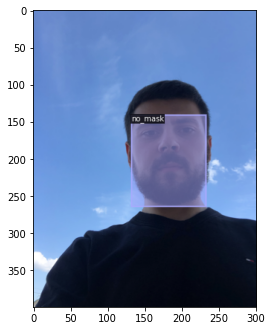

=======================Result===============================
                     name   labels  xmin  ymin  xmax  ymax  height  width
3929  maksssksksss837.png  no_mask    95   151   192   261   400.0  301.0


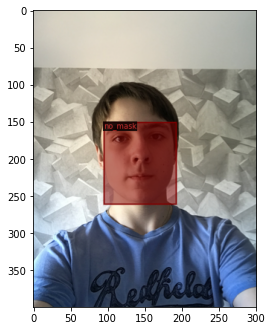

In [ ]:
dataset_dicts = DatasetCatalog.get("data_test")
for i, img_file in enumerate(pics_wrong):
  for d in dataset_dicts:
    if d["file_name"] == img_file:
      print("=======================Result===============================")
      print(test_df[test_df.name== d["file_name"][12:]])
      img = cv2.imread(d["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata)
      vis = visualizer.draw_dataset_dict(d)
      plt.figure(figsize = (4, 8))
      plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
      plt.show()


**Visualize the COCO mAP Results**

=======================Result===============================
COCO mAP: 0.7


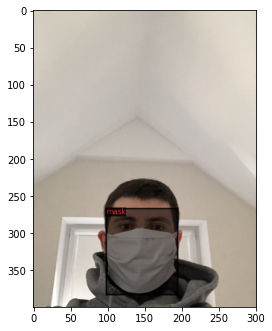

=======================Result===============================
COCO mAP: 0.8009901


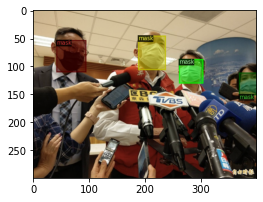

=======================Result===============================
COCO mAP: 0.0


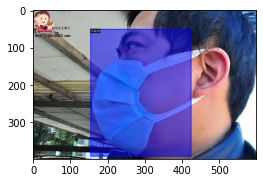

=======================Result===============================
COCO mAP: 0.2737399


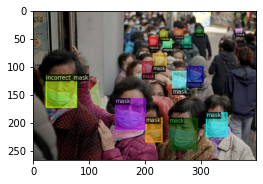

=======================Result===============================
COCO mAP: 0.0


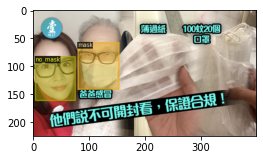

=======================Result===============================
COCO mAP: 0.0


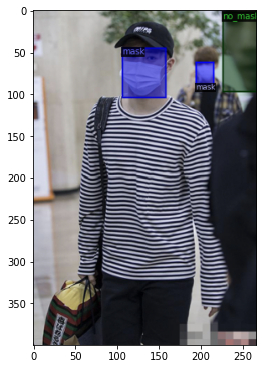

=======================Result===============================
COCO mAP: 0.550495


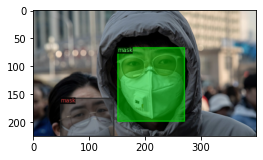

=======================Result===============================
COCO mAP: 0.4


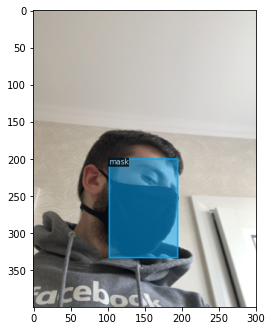

=======================Result===============================
COCO mAP: 0.8


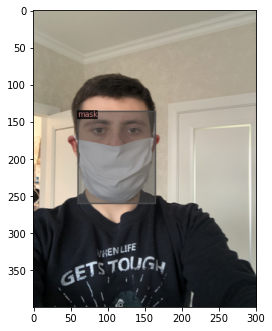

=======================Result===============================
COCO mAP: 0.4


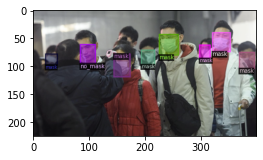

=======================Result===============================
COCO mAP: 0.45247525


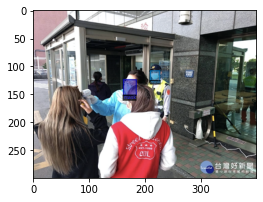

=======================Result===============================
COCO mAP: 0.5074257


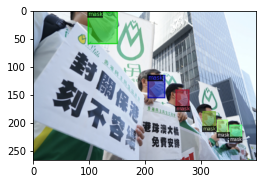

=======================Result===============================
COCO mAP: 0.52871287


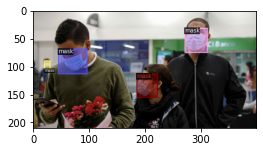

=======================Result===============================
COCO mAP: 0.6


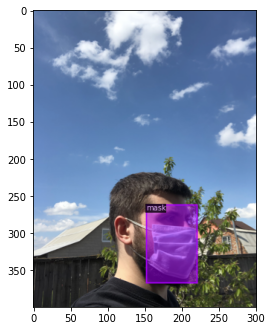

=======================Result===============================
COCO mAP: 0.20928493


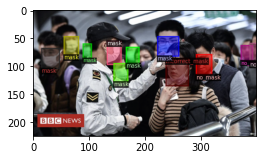

=======================Result===============================
COCO mAP: 0.0


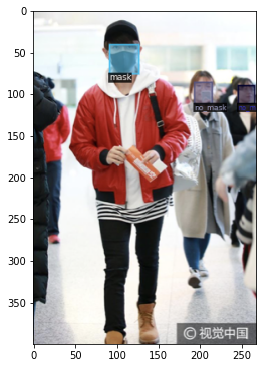

=======================Result===============================
COCO mAP: 0.85049504


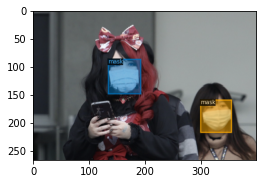

=======================Result===============================
COCO mAP: 0.5359736


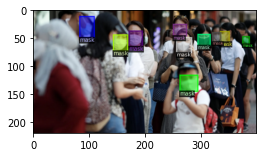

=======================Result===============================
COCO mAP: 0.8


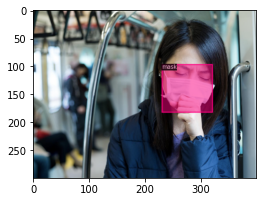

=======================Result===============================
COCO mAP: 0.2019802


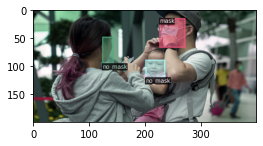

=======================Result===============================
COCO mAP: 0.6


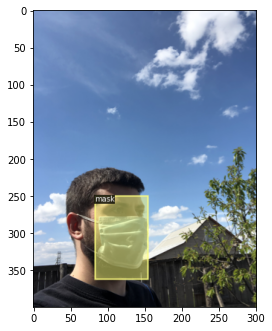

=======================Result===============================
COCO mAP: 0.67722774


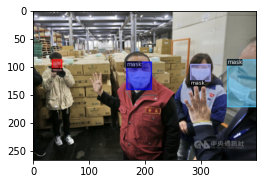

=======================Result===============================
COCO mAP: 0.8


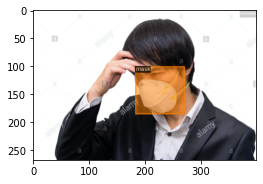

=======================Result===============================
COCO mAP: 0.0


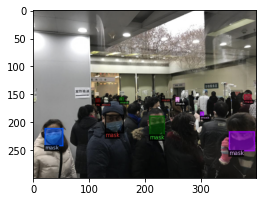

=======================Result===============================
COCO mAP: 0.49051157


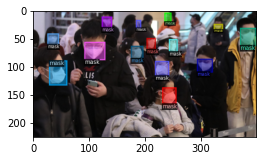

=======================Result===============================
COCO mAP: 0.7757426


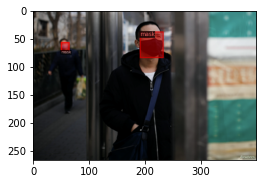

=======================Result===============================
COCO mAP: 0.2364361


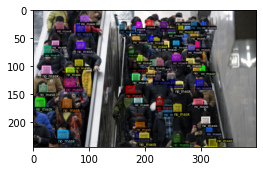

=======================Result===============================
COCO mAP: 0.8


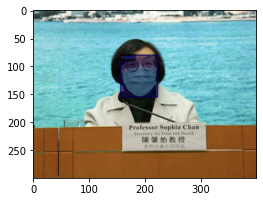

=======================Result===============================
COCO mAP: 0.9


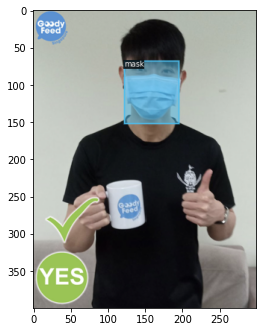

=======================Result===============================
COCO mAP: 0.69415843


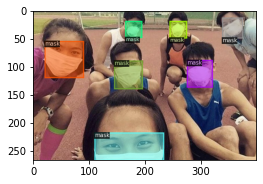

=======================Result===============================
COCO mAP: 0.0


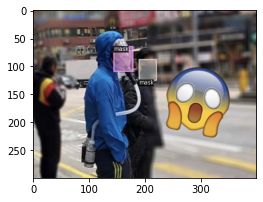

=======================Result===============================
COCO mAP: 0.7252475


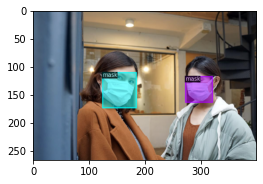

=======================Result===============================
COCO mAP: 0.0


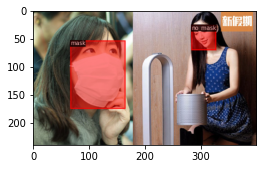

=======================Result===============================
COCO mAP: 0.050990097


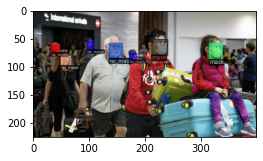

=======================Result===============================
COCO mAP: 0.7


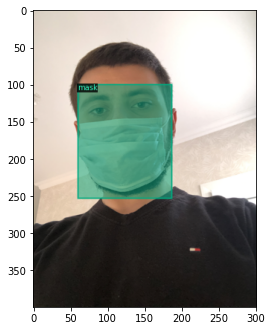

=======================Result===============================
COCO mAP: 0.35


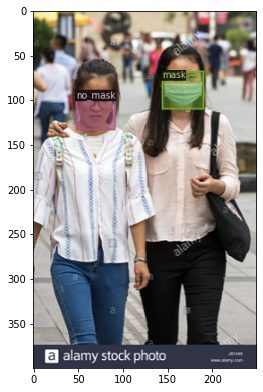

=======================Result===============================
COCO mAP: 0.64950496


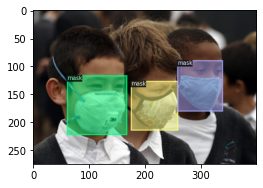

=======================Result===============================
COCO mAP: 0.2


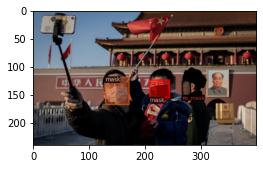

=======================Result===============================
COCO mAP: 0.9


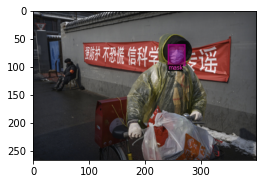

=======================Result===============================
COCO mAP: 0.6


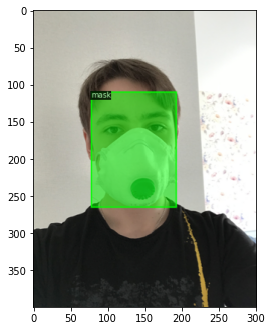

=======================Result===============================
COCO mAP: 0.3443894


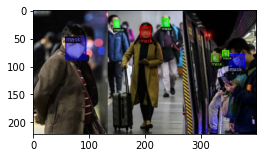

=======================Result===============================
COCO mAP: 0.85049504


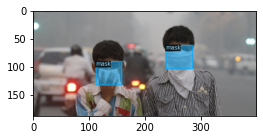

=======================Result===============================
COCO mAP: 0.0


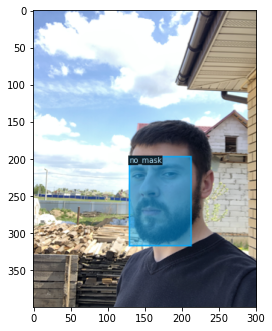

=======================Result===============================
COCO mAP: 0.0


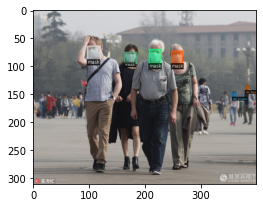

=======================Result===============================
COCO mAP: 0.0


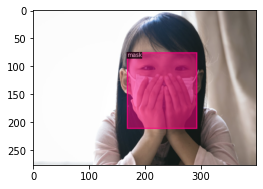

=======================Result===============================
COCO mAP: 0.8


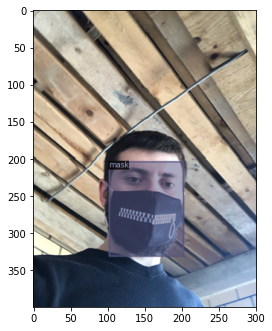

=======================Result===============================
COCO mAP: 0.7407591


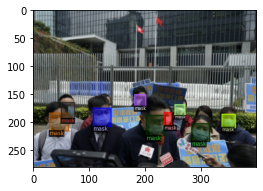

=======================Result===============================
COCO mAP: 0.17801979


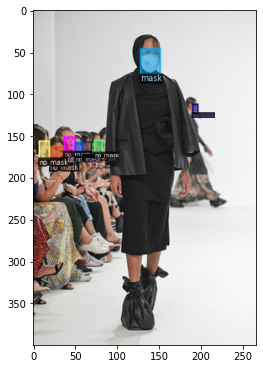

=======================Result===============================
COCO mAP: 0.0


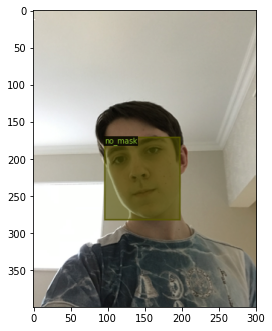

=======================Result===============================
COCO mAP: 0.7


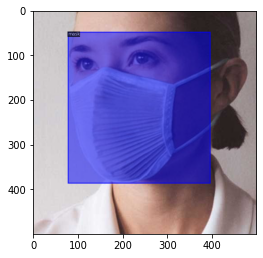

=======================Result===============================
COCO mAP: 0.46435642


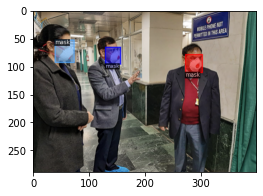

=======================Result===============================
COCO mAP: 0.7673267


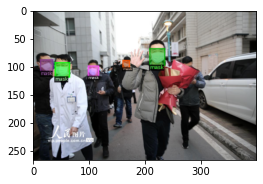

=======================Result===============================
COCO mAP: 0.8


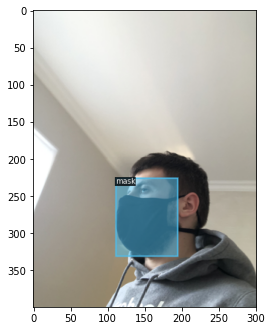

=======================Result===============================
COCO mAP: 0.28217822


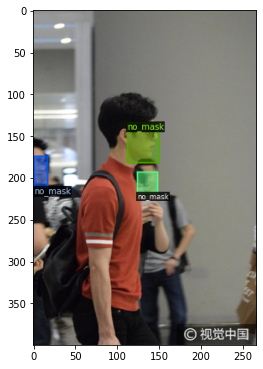

=======================Result===============================
COCO mAP: 0.15


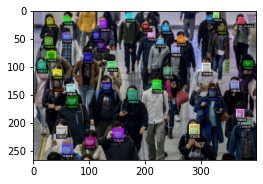

=======================Result===============================
COCO mAP: 0.6


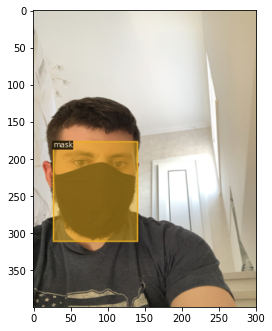

=======================Result===============================
COCO mAP: 0.8


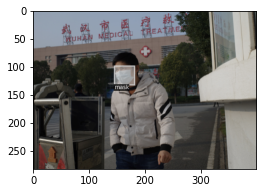

=======================Result===============================
COCO mAP: 0.465653


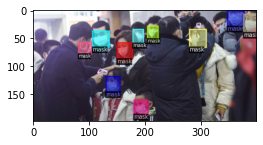

=======================Result===============================
COCO mAP: 0.0


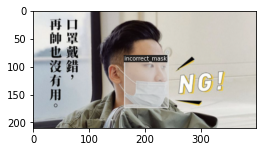

=======================Result===============================
COCO mAP: 0.8


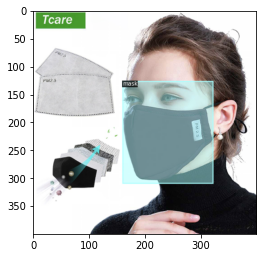

=======================Result===============================
COCO mAP: 0.7


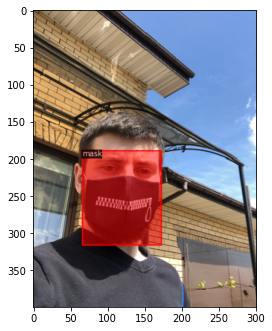

=======================Result===============================
COCO mAP: 0.6


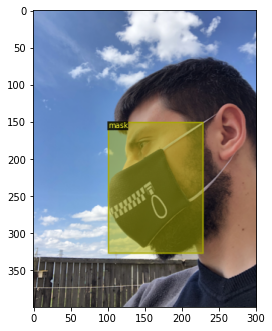

=======================Result===============================
COCO mAP: 0.5666667


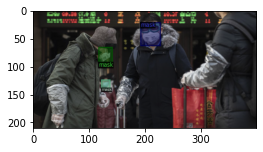

=======================Result===============================
COCO mAP: 0.0


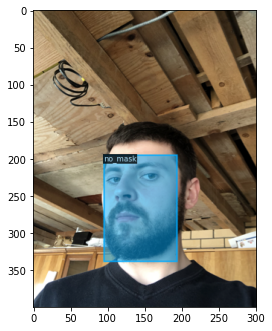

=======================Result===============================
COCO mAP: 0.0


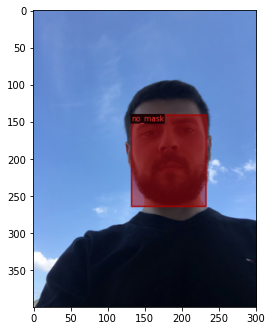

=======================Result===============================
COCO mAP: 0.8252711


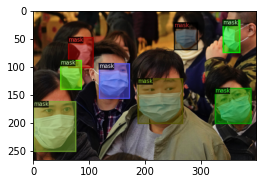

=======================Result===============================
COCO mAP: 0.5679868


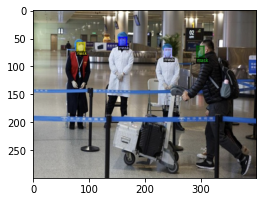

=======================Result===============================
COCO mAP: 0.40000004


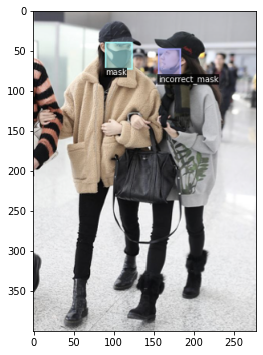

=======================Result===============================
COCO mAP: 0.0


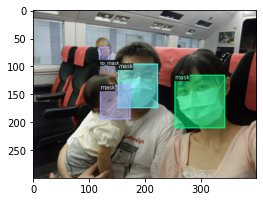

=======================Result===============================
COCO mAP: 0.23116061


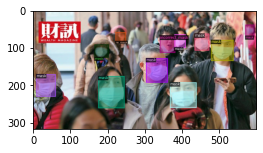

=======================Result===============================
COCO mAP: 0.7


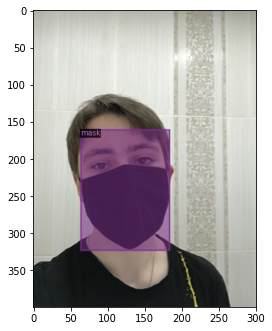

=======================Result===============================
COCO mAP: 0.0


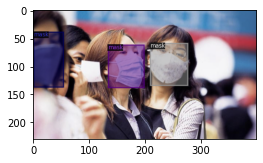

=======================Result===============================
COCO mAP: 0.29744226


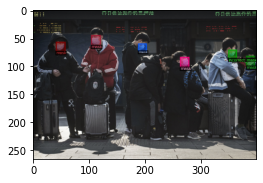

=======================Result===============================
COCO mAP: 0.17673269


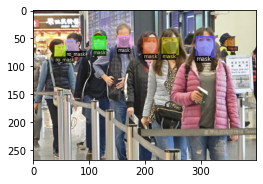

=======================Result===============================
COCO mAP: 0.31155115


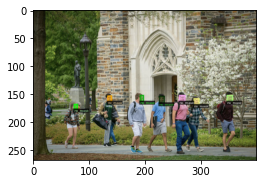

=======================Result===============================
COCO mAP: 0.0


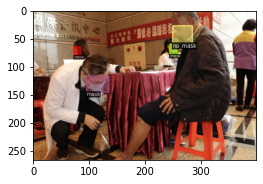

=======================Result===============================
COCO mAP: 0.8


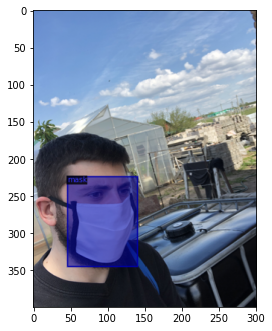

=======================Result===============================
COCO mAP: 0.4


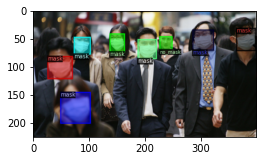

=======================Result===============================
COCO mAP: 0.7341584


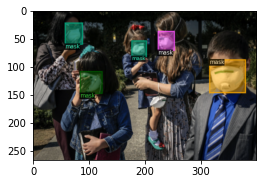

=======================Result===============================
COCO mAP: 0.8


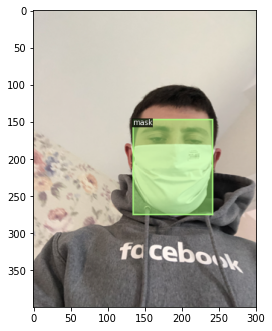

=======================Result===============================
COCO mAP: 0.4


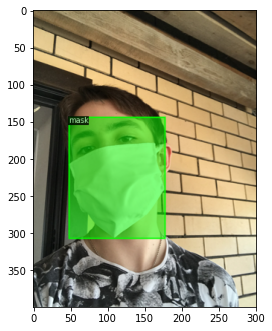

=======================Result===============================
COCO mAP: 0.8


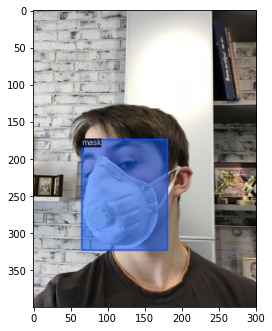

=======================Result===============================
COCO mAP: 0.0


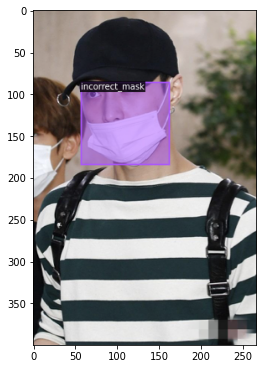

=======================Result===============================
COCO mAP: 0.0


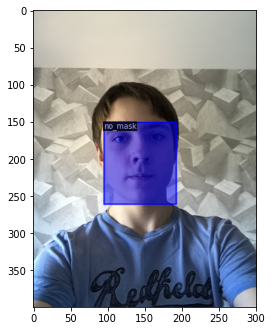

=======================Result===============================
COCO mAP: 0.0


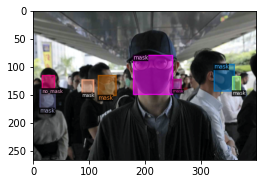

In [ ]:
with open('aug_test_result.json', 'r') as content_file:
    content = content_file.read()

for e in eval(content):
  for d in dataset_dicts:
    if d["file_name"] == e['file_name']:
      print("=======================Result===============================")
      print("COCO mAP: {0}".format(e['coco_map']))
      img = cv2.imread(d["file_name"])
      visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata)
      vis = visualizer.draw_dataset_dict(d)
      plt.figure(figsize = (4, 8))
      plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
      plt.show()

* Visualize the images that have  COCO mAP = 0.0. It is obviously that the mAP for the test dataset does not improve after data augmentation. 21 images have 0.0 mAP.

=======================Result===============================
COCO mAP: 0.0


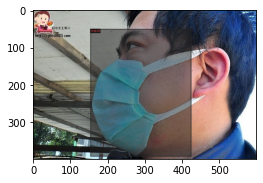

=======================Result===============================
COCO mAP: 0.0


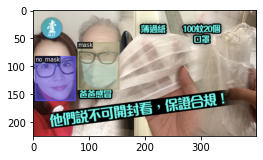

=======================Result===============================
COCO mAP: 0.0


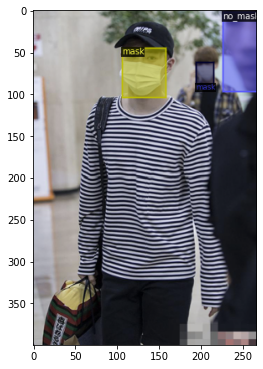

=======================Result===============================
COCO mAP: 0.0


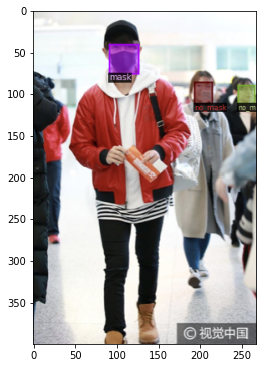

=======================Result===============================
COCO mAP: 0.0


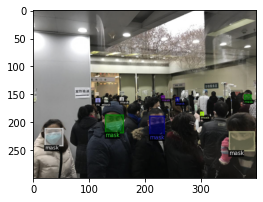

=======================Result===============================
COCO mAP: 0.0


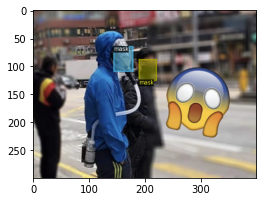

=======================Result===============================
COCO mAP: 0.0


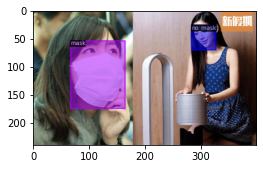

=======================Result===============================
COCO mAP: 0.0


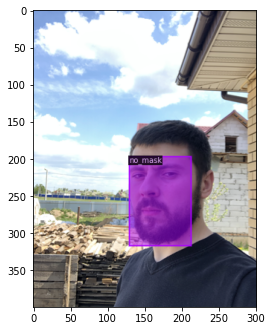

=======================Result===============================
COCO mAP: 0.0


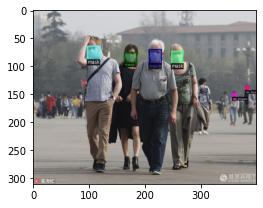

=======================Result===============================
COCO mAP: 0.0


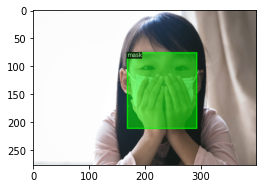

=======================Result===============================
COCO mAP: 0.0


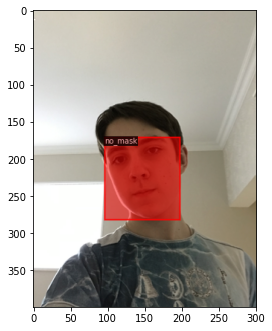

=======================Result===============================
COCO mAP: 0.0


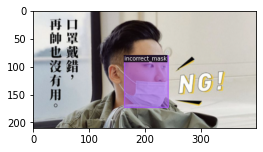

=======================Result===============================
COCO mAP: 0.0


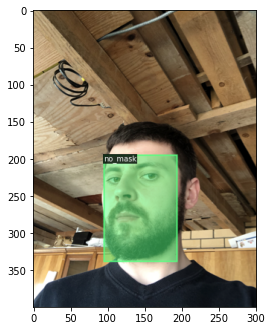

=======================Result===============================
COCO mAP: 0.0


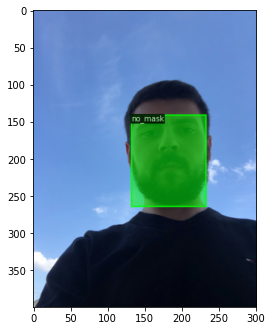

=======================Result===============================
COCO mAP: 0.0


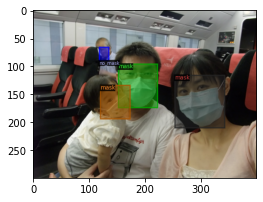

=======================Result===============================
COCO mAP: 0.0


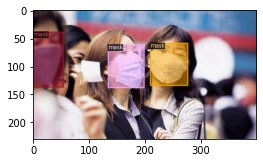

=======================Result===============================
COCO mAP: 0.0


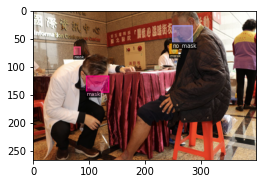

=======================Result===============================
COCO mAP: 0.0


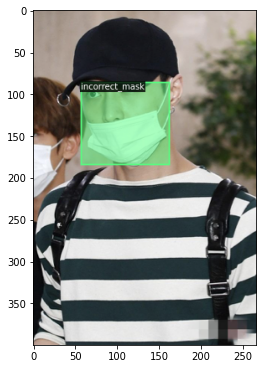

=======================Result===============================
COCO mAP: 0.0


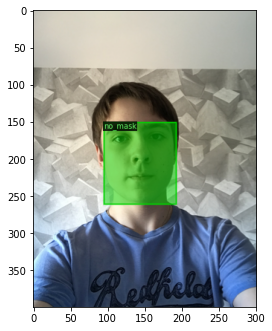

=======================Result===============================
COCO mAP: 0.0


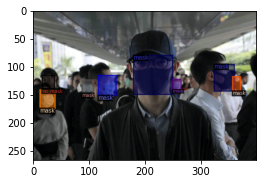

In [ ]:
for e in eval(content):
  for d in dataset_dicts:
    if d["file_name"] == e['file_name']:
      if e['coco_map'] == "0.0":
         print("=======================Result===============================")
         print("COCO mAP: {0}".format(e['coco_map']))
         img = cv2.imread(d["file_name"])
         visualizer = Visualizer(img[:, :, ::-1], metadata=statement_metadata)
         vis = visualizer.draw_dataset_dict(d)
         plt.figure(figsize = (4, 8))
         plt.imshow(cv2.cvtColor(vis.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
         plt.show()


When we compared the result of the model using training dataset with previous model,
The  model using augmentated training data  on the public test dataset do not improve the evaluation results:


```
[12/16 22:30:11 d2.evaluation.coco_evaluation]: Evaluation results for bbox: 
|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 37.588 | 68.505 | 36.145 | 37.460 | 40.238 | 39.727 |
[12/16 22:30:11 d2.evaluation.coco_evaluation]: Per-category bbox AP: 
| category   | AP     | category       | AP     | category   | AP     |
|:-----------|:-------|:---------------|:-------|:-----------|:-------|
| no_mask    | 42.202 | incorrect_mask | 12.973 | mask       | 57.590 |
```
The public test dataset results of the previous model:


```
[12/17 02:10:42 d2.evaluation.coco_evaluation]: Evaluation results for bbox: 
|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 57.382 | 85.591 | 68.904 | 44.330 | 65.717 | 82.895 |
[12/17 02:10:42 d2.evaluation.coco_evaluation]: Per-category bbox AP: 
| category   | AP     | category       | AP     | category   | AP     |
|:-----------|:-------|:---------------|:-------|:-----------|:-------|
| no_mask    | 47.702 | incorrect_mask | 58.993 | mask       | 65.450 |
```

Our augmentation techniques do not improve the model results.


After data augmentation, our results consisting of  the images with coco mAP = 0 are 18.

**The Evaluation of Segmentation**

The result of the model tarined with custom augmentation



```
[12/16 22:30:11 d2.evaluation.coco_evaluation]: Evaluation results for segm: 
|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 36.895 | 69.143 | 34.877 | 36.837 | 40.784 | 38.457 |
[12/16 22:30:11 d2.evaluation.coco_evaluation]: Per-category segm AP: 
| category   | AP     | category       | AP     | category   | AP     |
|:-----------|:-------|:---------------|:-------|:-----------|:-------|
| no_mask    | 41.128 | incorrect_mask | 14.049 | mask       | 55.509 |
```



The result of the previous model



```
[12/17 02:10:42 d2.evaluation.coco_evaluation]: Evaluation results for segm: 
|   AP   |  AP50  |  AP75  |  APs   |  APm   |  APl   |
|:------:|:------:|:------:|:------:|:------:|:------:|
| 59.665 | 86.633 | 68.344 | 45.465 | 67.758 | 85.991 |
[12/17 02:10:42 d2.evaluation.coco_evaluation]: Per-category segm AP: 
| category   | AP     | category       | AP     | category   | AP     |
|:-----------|:-------|:---------------|:-------|:-----------|:-------|
| no_mask    | 49.967 | incorrect_mask | 62.904 | mask       | 66.123 |
```



**Learning curves**

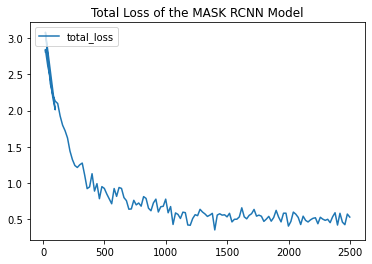

In [ ]:
experiment_metrics = load_json_arr('output/metrics.json')
total_it, total_loss = [], []
for x in experiment_metrics:
  if 'total_loss' in x :
     total_it.append(x['iteration'])
     total_loss.append(x['total_loss'] )
plt.plot(total_it,total_loss)
plt.title("Total Loss of the MASK RCNN Model")
plt.legend(['total_loss'], loc='upper left')
plt.show()

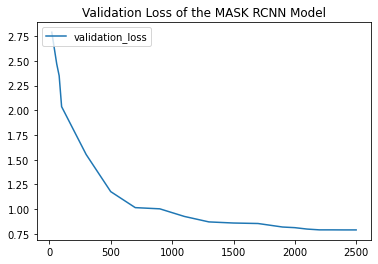

In [ ]:
total_it, val_loss =[], []

for x in experiment_metrics:
  if 'validation_loss' in x :
     total_it.append(x['iteration'])
     val_loss.append(x['validation_loss'] )
plt.plot(total_it,val_loss)
plt.title("Validation Loss of the MASK RCNN Model")
plt.legend(['validation_loss'], loc='upper left')
plt.show()


The result of the previous model




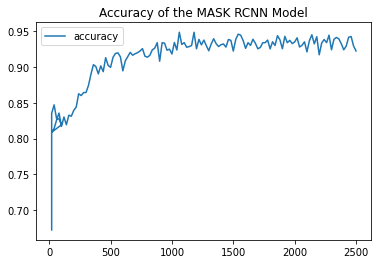

In [ ]:
experiment_metrics = load_json_arr('output/metrics.json')
total_it, accuracy =[], []

for x in experiment_metrics:
  if 'mask_rcnn/accuracy' in x :
     total_it.append(x['iteration'])
     accuracy.append(x['mask_rcnn/accuracy'] )
plt.plot(total_it,accuracy)
plt.title("Accuracy of the MASK RCNN Model")
plt.legend(['accuracy'], loc='upper left')
plt.show()


In [ ]:
!cp aug_test_result.json drive/MyDrive/CompetitionDL/

**As a result, we have to change the data augmentation parameters and techniques to improve the model because our suggested augmentation techniques do not improve the model.**

Default Data augmentation techniques of the model is enough for this problem. In addition to this, I have to return the first model.

# **References**

1. Kaggle solution: [Detectron2 Mask Detection](https://www.kaggle.com/tannergi/detectron2-mask-detection)
2. https://medium.com/@apofeniaco/training-on-detectron2-with-a-validation-set-and-plot-loss-on-it-to-avoid-overfitting-6449418fbf4e